
<h1>Segunda entrega - Proyecto de Procesamiento de datos a gran escala</h1>

<h2>Fecha: 26/05/2024</h2>


<h4>Programas</h4>
<h5>Ciencia de datos e Ingeniería de Sistemas</h5>
<h4>Integrantes</h4>
<p>Santiago Botero Pacheco</p>
<p>Santiago Rueda Pineda</p>
<p>Santiago Avilés Tibocha</p>
<p>Brayan Steven Carrillo Mora</p>
<p style = 'text-align:center;'>
<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/6/6c/Javeriana.svg/1200px-Javeriana.svg.png" height="200" width="300">
</p>


## Crear Entorno de Ejecución

In [0]:
#Importar bibliotecas necesarias para el analisis
import pandas as pd
import pyspark
from pyspark import SparkContext
from pyspark.sql import *
from pyspark.sql.functions import *
from pyspark.sql.types import *
import seaborn as sns
import matplotlib.pyplot as plt

In [0]:
#Crear el entorno (contexto) de Pyspark SQL
spark = SparkContext.getOrCreate()
spark = SparkSession.builder.appName("Proyecto1").getOrCreate()

sc = SparkContext.getOrCreate()
sql_c = SQLContext(sc)
sc

/databricks/spark/python/pyspark/sql/context.py:117: FutureWarning: Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.
  warnings.warn(


SparkContext 

 Spark UI 

 
 Version 
 v3.3.2 
 Master 
 local[8] 
 AppName 
 Databricks Shell

#Conjunto de datos Pobreza en NY

## Colección y descripción de datos:

In [0]:
#Crear dataset usando el path del repositorio de github

path = "https://raw.githubusercontent.com/Raaiinn/project-data-process/main/data/NYCgov_Poverty_Measure_Data__2018__20240410.csv"
pd_pobreza_df = pd.read_csv(path)
spark_pobreza_df = spark.createDataFrame(pd_pobreza_df) #Convertir a PySpark 

###Tabla de datos

In [0]:
spark_pobreza_df.limit(5).toPandas()

,SERIALNO,SPORDER,PWGTP,WGTP,AGEP,CIT,REL,SCH,SCHG,SCHL,...,Povunit_ID,Povunit_Rel,PreTaxIncome_PU,RETP_adj,RNTP_adj,SEMP_adj,SSIP_adj,SSP_adj,TotalWorkHrs_PU,WAGP_adj
0,1,1,95,95,31,1,0,1,0,22.0,...,1,1,127650.22,0.0,0.0,0.0,0.0,0.000,2,127650.220
1,16,1,181,181,63,1,0,1,0,22.0,...,1,1,346479.19,0.0,0.0,0.0,0.0,0.000,2,182357.450
2,16,2,210,181,65,1,1,1,0,19.0,...,1,2,346479.19,0.0,0.0,0.0,0.0,12157.164,2,0.000
3,47,1,62,62,68,4,0,1,0,1.0,...,1,1,155003.84,0.0,0.0,0.0,0.0,27353.619,1,91178.727
4,47,2,71,62,63,4,1,1,0,1.0,...,1,2,155003.84,0.0,0.0,0.0,0.0,0.000,1,36471.492


### Tipos de datos encontrados en el dataframe extraído

In [0]:
spark_pobreza_df.printSchema()

root
 |-- SERIALNO: long (nullable = true)
 |-- SPORDER: long (nullable = true)
 |-- PWGTP: long (nullable = true)
 |-- WGTP: long (nullable = true)
 |-- AGEP: long (nullable = true)
 |-- CIT: long (nullable = true)
 |-- REL: long (nullable = true)
 |-- SCH: long (nullable = true)
 |-- SCHG: long (nullable = true)
 |-- SCHL: double (nullable = true)
 |-- SEX: long (nullable = true)
 |-- ESR: double (nullable = true)
 |-- LANX: double (nullable = true)
 |-- ENG: double (nullable = true)
 |-- MSP: double (nullable = true)
 |-- MAR: long (nullable = true)
 |-- WKW: double (nullable = true)
 |-- WKHP: long (nullable = true)
 |-- DIS: long (nullable = true)
 |-- JWTR: double (nullable = true)
 |-- NP: long (nullable = true)
 |-- TEN: long (nullable = true)
 |-- HHT: long (nullable = true)
 |-- AgeCateg: long (nullable = true)
 |-- Boro: long (nullable = true)
 |-- CitizenStatus: long (nullable = true)
 |-- EducAttain: double (nullable = true)
 |-- EST_Childcare: double (nullable = true)
 |-

### Diccionario de Datos
* **serialno**: Número de serie o identificador del registro individual.
* **sporder**: Orden secuencial de la persona en el hogar.
* **pwgtp**: Peso de la persona.
* **wgtp**: Peso del hogar.
* **agep**: Edad de la persona.
* **cit**: Estado de ciudadanía.
* **rel**: Relación con el cabeza de familia.
* **sch**: Asistencia a la escuela.
* **schg**: Grado al que asiste.
* **Schl**: Nivel de estudios.
* **sex**: Sexo.
* **esr**: Situación laboral.
* **lanx**: Idioma hablado en casa.
* **msp**: Estado civil.
* **mar**: Historial matrimonial.
* **wkw**: Semanas trabajadas.
* **wkhp**: Horas trabajadas por semana.
* **dis**: Situación de discapacidad.
* **jwtr**: Medio de transporte al trabajo.
* **np**: Número de personas en el hogar.
* **ten**: Tenencia. (propietario/alquilador).
* **hht**: Tipo de hogar.
* **agecateg**: Categoría de edad.
* **boro**: Municipio.
* **citizenstatus**: Estado de nacionalidad.
* **educattain**: Nivel de estudios.
* **est_childcare**: Gastos estimados de guardería.
* **est_commuting**: Gastos estimados de desplazamiento al trabajo.
* **est_eitc**: Estimación del EITC (crédito fiscal por ingresos del trabajo).
* **est_ficatax**: Estimación del impuesto FICA.
* **est_heap**: Estimación HEAP (Home Energy Assistance Program).
* **est_housing**: Gastos estimados de vivienda.
* **est_incometax**: Estimación del impuesto sobre la renta.
* **est_moop**: Estimación del MOOP (gasto máximo de bolsillo).
* **est_nutrition**: Gastos estimados de nutrición.
* **est_povgap**:Brecha de pobreza estimada.
* **est_povgapindex**:Índice estimado de la brecha de pobreza.
* **ethnicity**: Etnia.
* **famtype_pu**: Tipo de familia.
* **ftptwork**: Situación laboral a tiempo completo o parcial.
* **intp_adj**: Ajuste de los ingresos por intereses.
* **mrgp_adj**: Ajuste del pago de la hipoteca.
* **nycgov_income**: Ingresos del gobierno de NYC.
* **nycgov_pov_stat**: Estado de pobreza del gobierno de NYC.
* **nycgov_rel**: Relación con el gobierno de NYC.
* **nycgov_threshold**: Umbral del gobierno de NYC.
* **Off_pov_stat**: Estado oficial de pobreza.
* **off_threshold**: Umbral oficial de pobreza.
* **oi_adj**: Ajuste por otros ingresos.
* **pa_adj**: Ajuste de ingresos por asistencia pública.
* **Povunit_id**: ID de la unidad de pobreza.
* **povunit_rel**: Relación con la unidad de pobreza.
* **pretaxincome_pu**: Renta antes de impuestos.
* **retp_adj**: Ajuste de ingresos por jubilación.
* **rntp_adj**: Ajuste de la renta de alquiler.
* **semp_adj**: Ajuste de los ingresos por trabajo autónomo.
* **ssip_adj**: upplemental Security Income (SSI) adjustment.
* **ssp_adj**: Ajuste de los ingresos de la Seguridad Social.
* **totalworkhrs_pu**: *Total de horas de trabajo por unidad de pobreza.
* **wagp_adj**: Ajuste de los ingresos salariales.
* **eng**: Dominio del inglés.

### Seleccion de columnas de interes

Seleccionamos las siguientes columnas pues pueden ser las que más sentido e impacto traigan a nuestro análisis

- **agep**	Edad de la persona, que puede proporcionar información sobre las tasas de pobreza en diferentes grupos de edad.
- **schl**	Nivel de educación, ya que está estrechamente relacionado con las oportunidades de empleo y los niveles de ingresos.
- **sex**	Género, para examinar las posibles diferencias en las tasas de pobreza entre hombres y mujeres.
- **wkw y wkhp**	Semanas trabajadas y horas trabajadas por semana, que pueden indicar el estado de empleo y los niveles de ingresos.
- **msp**	Estado civil, ya que puede influir en la estructura y los recursos del hogar.
- **hht**	Tipo de hogar, para entender cómo diferentes composiciones de los hogares se ven afectadas por la pobreza.
- **boro**	Util para identificar posibles desbalances geográficos en la pobreza dentro de la ciudad de Nueva York.
- **ethnicity**: Dato demografico de interes.
- **est_childcare, est_commuting, est_housing**	Gastos estimados que pueden afectar significativamente la situación financiera de un hogar.
- **est_povgap y est_povgapindex**	Medidas de la profundidad de la pobreza, que proporcionan información sobre la gravedad del problema.
- **nycgov_pov_stat y off_pov_stat**	Estado de pobreza oficial según las medidas del gobierno de la ciudad de Nueva York y el gobierno federal, lo que permite realizar comparaciones.
- **pretaxincome_pu**	Ingresos pre-impuestos por unidad de pobreza, un indicador clave de los recursos financieros.
- **totalworkhrs_pu**	Total de horas trabajadas por unidad de pobreza, capturando la intensidad del empleo.

In [0]:
#Debido a la gran cantidad de columnas presentes en el dataset, vamos a eliminar y limpiar algunas para elegir las de mayor interés para nosotros
columns_to_keep = ['agep', 'schl', 'sex', 'wkw', 'wkhp', 'msp', 'hht', 'boro', 'ethnicity',
                   'est_childcare', 'est_commuting', 'est_housing', 'est_povgap', 
                   'est_povgapindex', 'nycgov_pov_stat', 'off_pov_stat', 'pretaxincome_pu', 
                   'totalworkhrs_pu']
clean_spark_poverty = spark_pobreza_df.select(*columns_to_keep)

#Se cambiara el nombre de las columnas para mayor interpretación
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('agep', 'edad')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('schl', 'educacion')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('sex', 'sexo')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('wkw', 'semanas_trabajadas')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('wkhp', 'horas_trabajadas')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('msp', 'estado_civil')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('hht', 'tipo_hogar')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('boro', 'condado')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('ethnicity', 'etnia')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_childcare','est_cuidado_infantil')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_commuting', 'est_transporte')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_housing', 'est_vivienda')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_povgap', 'brecha_pobreza')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_povgapindex', 'indice_brecha_pobreza')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('nycgov_pov_stat', 'estado_pobreza_nyc')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('off_pov_stat', 'estado_pobreza_oficial')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('pretaxincome_pu', 'ingresos_pre_impuestos')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('totalworkhrs_pu', 'tot_hrs_trabajo_pu')

clean_spark_poverty.limit(5).toPandas()

,edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,31,22.0,2,1.0,60,6.0,6,2,4,0.0,1722.0000,1478.3278,0.0,0.0,2,2,127650.22,2
1,63,22.0,2,1.0,60,1.0,1,3,1,0.0,3840.8416,0.0000,0.0,0.0,2,2,346479.19,2
2,65,19.0,1,NaN,0,1.0,1,3,1,0.0,3840.8416,0.0000,0.0,0.0,2,2,346479.19,2
3,68,1.0,1,1.0,40,1.0,1,2,1,0.0,0.0000,2612.8022,0.0,0.0,2,2,155003.84,1
4,63,1.0,2,1.0,40,1.0,1,2,1,0.0,0.0000,2612.8022,0.0,0.0,2,2,155003.84,1


## EDA - Análisis Exploratorio

### Estadisticos de todas las columnas
- Al ser todas las columnas valores numericos se espera un reporte sin errores o valores nulos

In [0]:
display(clean_spark_poverty.describe())

summary,edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
count,68273,66166,68273,36879,68273,57252,68273,68273,68273,68273,68273,68273,68273,68273,68273,68273,68273,68273
mean,39.64726905218754,16.14156817700934,1.5316010721661564,1.731690121749505,20.731738754705376,3.479616432613708,2.3407349904061636,2.786767829156475,2.3928932374437917,1164.697401094199,2290.999144816122,2840.644254834593,1789.325946137725,0.06397607685464375,1.8225799364316786,1.8583041612350417,112312.04741030838,2.478007411421792
stddev,22.568387312563864,6.03218267734675,0.4990040274727757,1.484705855251405,21.180743230758136,2.272040232015264,1.8116524586303995,1.1955370075737919,1.2846842100042102,5082.004878976743,2673.167872306873,5582.069830025632,5324.368887048603,0.1846559232647502,0.3820265989034003,0.3487404614007823,135766.82132941092,1.4405105758063659
min,0,1.0,1,1.0,0,1.0,1,1,1,0.0,0.0,0.0,0.0,0.0,1,1,-6787.75,1
max,95,24.0,2,6.0,99,6.0,7,5,5,50803.949,37763.5,36710.223,54978.477,1.0,2,2,1782037.6,5


### Graficas de Interés

#### Distribución de edades

In [0]:
clean_spark_poverty.createOrReplaceTempView("data_eda") #Crear vista tempral

In [0]:
%sql
SELECT edad FROM data_eda

edad
31
63
65
68
63
29
25
32
76
46


Databricks visualization. Run in Databricks to view.

#### Distribución del nivel de educación

In [0]:
%sql
SELECT educacion FROM data_eda

educacion
22.0
22.0
19.0
1.0
1.0
21.0
21.0
16.0
21.0
17.0


Databricks visualization. Run in Databricks to view.

#### Distribución por sexo

In [0]:
%sql
SELECT sexo, count(sexo) as Fecuencia FROM data_eda GROUP BY sexo

sexo,Fecuencia
1,31979
2,36294


Databricks visualization. Run in Databricks to view.

#### Ingresos pre-impuestos vs total de horas trabajadas


In [0]:
%sql

SELECT ingresos_pre_impuestos, tot_hrs_trabajo_pu FROM data_eda

ingresos_pre_impuestos,tot_hrs_trabajo_pu
127650.22,2
346479.19,2
346479.19,2
155003.84,1
155003.84,1
28670.645,1
28670.645,1
50654.852,3
43664.48,5
80034.664,2


Databricks visualization. Run in Databricks to view.

#### Distribucion brecha de pobreza

In [0]:
%sql
SELECT brecha_pobreza FROM data_eda

brecha_pobreza
0.0
0.0
0.0
0.0
0.0
3214.7793
3214.7793
0.0
0.0
0.0


Databricks visualization. Run in Databricks to view.

### Resumen usando Histogramas

In [0]:
%sql
select * from data_eda

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
31,22.0,2,1.0,60,6.0,6,2,4,0.0,1722.0,1478.3278,0.0,0.0,2,2,127650.22,2
63,22.0,2,1.0,60,1.0,1,3,1,0.0,3840.8416,0.0,0.0,0.0,2,2,346479.19,2
65,19.0,1,null,0,1.0,1,3,1,0.0,3840.8416,0.0,0.0,0.0,2,2,346479.19,2
68,1.0,1,1.0,40,1.0,1,2,1,0.0,0.0,2612.8022,0.0,0.0,2,2,155003.84,1
63,1.0,2,1.0,40,1.0,1,2,1,0.0,0.0,2612.8022,0.0,0.0,2,2,155003.84,1
29,21.0,2,1.0,40,1.0,1,4,4,0.0,4954.1665,0.0,3214.7793,0.14037937,1,2,28670.645,1
25,21.0,1,1.0,40,1.0,1,4,4,0.0,4954.1665,0.0,3214.7793,0.14037937,1,2,28670.645,1
32,16.0,1,1.0,40,6.0,1,4,4,0.0,6703.5,0.0,0.0,0.0,2,2,50654.852,3
76,21.0,1,null,0,3.0,4,2,2,0.0,0.0,0.0,0.0,0.0,2,2,43664.48,5
46,17.0,2,1.0,35,1.0,1,2,3,0.0,1795.8,0.0,0.0,0.0,2,2,80034.664,2


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

## Reporte de Calidad de Datos

In [0]:
display(clean_spark_poverty.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in clean_spark_poverty.columns]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,2107,0,31394,0,11021,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
#Proporcion de nulos segun el total de datos
null_counts = []

for column in clean_spark_poverty.columns:
    # Contar los valores nulos en la columna actual
    null_count = clean_spark_poverty.filter(clean_spark_poverty[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count / clean_spark_poverty.count()}")

Cantidad de valores nulos en la columna 'edad': 0.0
Cantidad de valores nulos en la columna 'educacion': 0.030861394694828116
Cantidad de valores nulos en la columna 'sexo': 0.0
Cantidad de valores nulos en la columna 'semanas_trabajadas': 0.4598303868293469
Cantidad de valores nulos en la columna 'horas_trabajadas': 0.0
Cantidad de valores nulos en la columna 'estado_civil': 0.1614254536932609
Cantidad de valores nulos en la columna 'tipo_hogar': 0.0
Cantidad de valores nulos en la columna 'condado': 0.0
Cantidad de valores nulos en la columna 'etnia': 0.0
Cantidad de valores nulos en la columna 'est_cuidado_infantil': 0.0
Cantidad de valores nulos en la columna 'est_transporte': 0.0
Cantidad de valores nulos en la columna 'est_vivienda': 0.0
Cantidad de valores nulos en la columna 'brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'indice_brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'estado_pobreza_nyc': 0.0
Cantidad de valores nulos en la columna 'estado_p

Como podemos observar, los valores nulos se concentran solamente en tres de las columnas que hemos seleccionado: 'educacion' , 'semanas_trabajadas' y 'estado_civil'. Esto siginifica que los datos tienen una calidad bastante considerable pues estos valores faltantes no afectan la globalidad del análisis que se esté planteando.

Lo mismo aplica para valores iguales a 0 en ciertas columnas donde este dato no es aceptable. Esto incluye columnas como 'edad', en donde el indice de pobreza no puede contemplar valores tan bajos de edad pero que igualmente la gráfica los continene. 

## Limpieza y Transformación

### Tratamiento de Inconsistencia en columna Edad (Valor 0)

In [0]:
%sql
-- Se muestra el resumen estadistico para la columna de edad
SELECT * FROM data_eda WHERE edad == 0


edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,null,2,null,0,null,1,3,5,38102.961,984.0,0.0,0.0,0.0,2,2,314566.63,1
0,null,2,null,0,null,3,2,4,0.0,984.0,11496.932,0.0,0.0,2,1,25327.426,3
0,null,2,null,0,null,1,2,4,0.0,1722.0,0.0,0.0,0.0,2,2,31304.697,1
0,null,2,null,0,null,3,2,2,0.0,4093.4399,0.0,0.0,0.0,2,2,129250.91,1
0,null,1,null,0,null,1,4,1,0.0,6131.4678,0.0,0.0,0.0,2,2,123699.14,2
0,null,2,null,0,null,3,3,4,30482.369,2214.0,0.0,9522.3691,0.30871534,1,2,55213.785,1
0,null,1,null,0,null,1,2,1,12157.164,1230.0,0.0,4110.1836,0.095893785,1,2,47615.559,1
0,null,1,null,0,null,1,2,1,12700.987,4581.75,0.0,0.0,0.0,2,2,187422.94,1
0,null,1,null,0,null,3,1,2,0.0,708.47998,13623.04,0.0,0.0,2,1,10445.03,4
0,null,2,null,0,null,1,2,1,0.0,2175.7334,20164.873,0.0,0.0,2,2,40523.879,2


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Se encontro que los datos que tienen 0 en la edad en la mayoria de columnas con tienen un valor nulo. Sin embargo, en las que si tienen registros solo en la columna de Ingresos pre impuestos no tendria sentido basado en la hipotesis de que sea un niño recien nacido. **Se concluye que es informacion faltante**

In [0]:
#Determinamos que los 0 son nulos para la columna edad, se procede a cambiar los valores por nulos
clean_spark_poverty = clean_spark_poverty.withColumn("edad", when(clean_spark_poverty["edad"] == 0, None).otherwise(clean_spark_poverty["edad"]))

In [0]:
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
686,2107,0,31394,0,11021,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
#Reporte de nulos actualizado
#Proporcion de nulos segun el total de datos
null_counts = []

for column in clean_spark_poverty.columns:
    # Contar los valores nulos en la columna actual
    null_count = clean_spark_poverty.filter(clean_spark_poverty[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count / clean_spark_poverty.count()}")

Cantidad de valores nulos en la columna 'edad': 0.01004789594715334
Cantidad de valores nulos en la columna 'educacion': 0.030861394694828116
Cantidad de valores nulos en la columna 'sexo': 0.0
Cantidad de valores nulos en la columna 'semanas_trabajadas': 0.4598303868293469
Cantidad de valores nulos en la columna 'horas_trabajadas': 0.0
Cantidad de valores nulos en la columna 'estado_civil': 0.1614254536932609
Cantidad de valores nulos en la columna 'tipo_hogar': 0.0
Cantidad de valores nulos en la columna 'condado': 0.0
Cantidad de valores nulos en la columna 'etnia': 0.0
Cantidad de valores nulos en la columna 'est_cuidado_infantil': 0.0
Cantidad de valores nulos en la columna 'est_transporte': 0.0
Cantidad de valores nulos en la columna 'est_vivienda': 0.0
Cantidad de valores nulos en la columna 'brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'indice_brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'estado_pobreza_nyc': 0.0
Cantidad de valores nulos en la c

### Tratamiento de nulos
Teniendo en consideracion el anterior reporte se llega a la conclusion de tratar a los nulos de la siguiente forma:

- **Edad**: Debido a la poca cantidad de datos (Menos del 2%) es mejor eliminarlos para evitar ruido en los futuros analisis.
- **Educación**: Debido a la poca cantidad de datos (Menos del 5%) es mejor eliminarlos para evitar ruido en los futuros analisis.
- **Semanas trabajadas**: Debido a que horas_trabajadas no tiene nulos usaremos una simple conversion de horas a semanas y redondearemos al numero mayor
- **Estado civil**: Se usara un algoritmo de clusterizacion no supervisado para encontrar los valores nulos

#### Nulos de la columna edad

In [0]:
#Eliminar datos nulos de la columna edad
clean_spark_poverty = clean_spark_poverty.na.drop(subset=["edad"])
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,1421,0,30708,0,10335,0,0,0,0,0,0,0,0,0,0,0,0


#### Nulos de la columna educación

In [0]:
#Eliminar nulos de la columna educación
#Eliminar datos nulos de la columna educacion
clean_spark_poverty = clean_spark_poverty.na.drop(subset=["educacion"])
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,0,0,29287,0,8914,0,0,0,0,0,0,0,0,0,0,0,0


#### Nulos de la columna semanas_trabajadas

In [0]:
#Predecir con contexto el valor de los nulos de la columna semanas_trabajadas
#Se tiene en cuenta que en Nueva York se trabajan 40 horas a la semana reglamentariamente
clean_spark_poverty = clean_spark_poverty.withColumn(
    "semanas_trabajadas",
    when(clean_spark_poverty["semanas_trabajadas"].isNull(), clean_spark_poverty["horas_trabajadas"] / 40).otherwise(clean_spark_poverty["semanas_trabajadas"])
)
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,0,0,0,0,8914,0,0,0,0,0,0,0,0,0,0,0,0


#### Nulos de la columna estado_civil

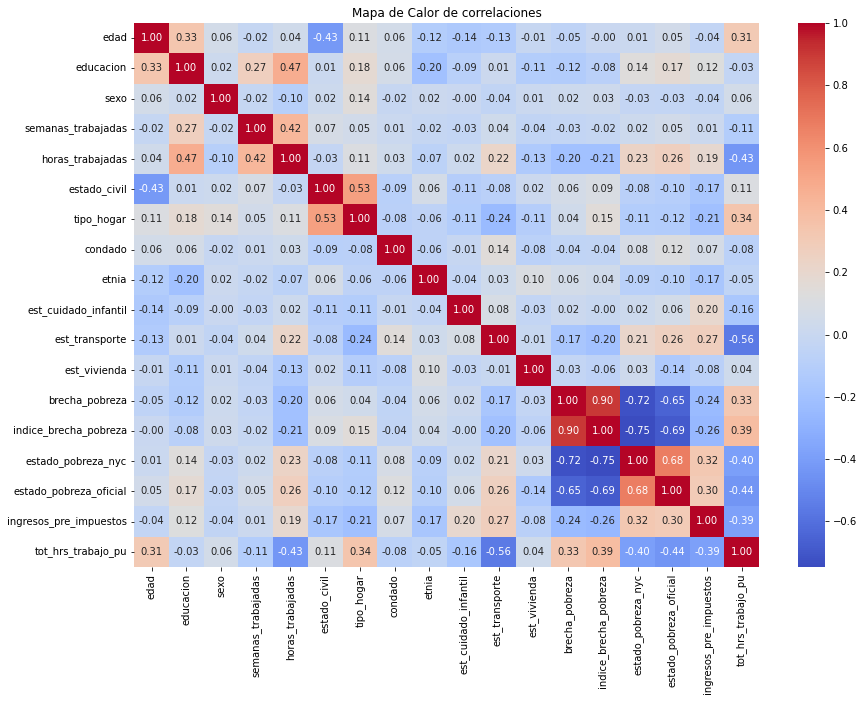

In [0]:
#Para encontrar los parametros con los que se va a predecir el estado_civil buscamos columnas correlacionadas
plt.figure(figsize=(14, 10))
sns.heatmap(clean_spark_poverty.toPandas().corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Mapa de Calor de correlaciones")
plt.show()

**Conclusion**: Se determino que las columnas mas correlacionadas son *tipo_hogar* con un 0.52 (Relacion proporcional), y *edad* con un -0.43 (Relacion inversamente proporcional)

In [0]:
print(f"Registros antes de la prediccion: {clean_spark_poverty.count()}")

Registros antes de la prediccion: 66166


In [0]:
#Aplicar modelo de kmean's para predecir columna de estado_civil
from sklearn.cluster import KMeans

df = clean_spark_poverty.toPandas()

# Aplicar el modelo (fit)
X = df[['tipo_hogar']]
kmeans = KMeans(n_clusters=6, random_state=42)
kmeans.fit(X)
df['cluster'] = kmeans.labels_

# Llenar los valores nulos
for cluster in df['cluster'].unique():
    cluster_df = df[df['cluster'] == cluster]
    estado_civil_mode = cluster_df['estado_civil'].mode()[0]
    df.loc[df['cluster'] == cluster, 'estado_civil'] = df.loc[df['cluster'] == cluster, 'estado_civil'].fillna(estado_civil_mode)

poverty_nonull = spark.createDataFrame(df)
poverty_nonull = poverty_nonull.drop("cluster")
display(poverty_nonull.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in poverty_nonull.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Calcular métricas 
silhouette = silhouette_score(X, kmeans.labels_)
calinski_harabasz = calinski_harabasz_score(X, kmeans.labels_)
davies_bouldin = davies_bouldin_score(X, kmeans.labels_)

print("Silhouette Score:", silhouette)
print("Calinski-Harabasz Index:", calinski_harabasz)
print("Davies-Bouldin Index:", davies_bouldin)

Silhouette Score: 0.9548501550492273
Calinski-Harabasz Index: 1945044.7389200698
Davies-Bouldin Index: 0.2575051319303065


- Silhouette Score: Moderadamente excelente, lo que indica que los clusters formados tienen una cohesión razonable
- Calinski-Harabasz Index: Valor bastante alto, lo que sugiere que los clusters están bien separados entre sí
- Davies-Bouldin Index: La similitud entre los clusters es relativamente baja

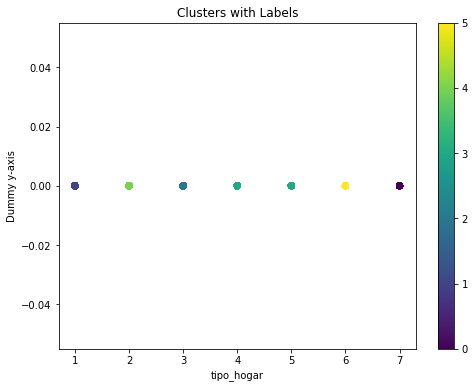

In [0]:
# Extraer las features del dataframe predictivo
X = poverty_nonull.toPandas()[['tipo_hogar']]
labels = kmeans.labels_

# Crear grafica de dispersion
plt.figure(figsize=(8, 6))
plt.scatter(X['tipo_hogar'], [0] * len(X), c=labels, cmap='viridis')
plt.xlabel('tipo_hogar')
plt.ylabel('Dummy y-axis')
plt.title('Clusters with Labels')
plt.colorbar()
plt.show()

## Estadisticos del dataset final

In [0]:
#Verifcar trasnformaciones con el metodo describe()
display(poverty_nonull.describe())

summary,edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,etnia,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
count,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166
mean,40.87774687906175,16.14156817700934,1.5331136837650756,0.965193603965783,21.391923344315813,3.3691624096968233,2.3673336759060546,2.791146510292295,2.3880542877006317,1041.0042468647966,2283.5762557632793,2834.2274832517187,1761.9731692674877,0.06373252148641233,1.8238370159900856,1.8601698757670102,111759.95199666507,2.488090560106399
stddev,21.828179119666963,6.032182677346752,0.49890604907914665,1.4030164784208237,21.1846008741458,2.3004270513244123,1.8276984018165496,1.1955916256752162,1.2806231840691016,4811.831543731292,2675.6736915000947,5564.060840909272,5267.625087228967,0.18469735126237216,0.3809616523013185,0.34681331928598536,135014.3252678254,1.4452088641768006
min,3,1.0,1,0.0,0,1.0,1,1,1,0.0,0.0,0.0,0.0,0.0,1,1,-6787.75,1
max,95,24.0,2,6.0,99,6.0,7,5,5,50803.949,37763.5,36710.223,54978.477,1.0,2,2,1782037.6,5


In [0]:
poverty_nonull.printSchema()


root
 |-- edad: long (nullable = true)
 |-- educacion: double (nullable = true)
 |-- sexo: long (nullable = true)
 |-- semanas_trabajadas: double (nullable = true)
 |-- horas_trabajadas: long (nullable = true)
 |-- estado_civil: double (nullable = true)
 |-- tipo_hogar: long (nullable = true)
 |-- condado: long (nullable = true)
 |-- etnia: long (nullable = true)
 |-- est_cuidado_infantil: double (nullable = true)
 |-- est_transporte: double (nullable = true)
 |-- est_vivienda: double (nullable = true)
 |-- brecha_pobreza: double (nullable = true)
 |-- indice_brecha_pobreza: double (nullable = true)
 |-- estado_pobreza_nyc: long (nullable = true)
 |-- estado_pobreza_oficial: long (nullable = true)
 |-- ingresos_pre_impuestos: double (nullable = true)
 |-- tot_hrs_trabajo_pu: long (nullable = true)



#Conjunto de datos de Arrestos en NY


In [0]:
#Crear dataset's usando los path's del repositorio de github

path_p1 = "https://raw.githubusercontent.com/Raaiinn/project-data-process/main/data/NYPD_Arresr_Data_P1.csv"
path_p2 = "https://raw.githubusercontent.com/Raaiinn/project-data-process/main/data/NYPD_Arresr_Data_P2.csv"

pd_arrestos_df_1 = pd.read_csv(path_p1)
pd_arrestos_df_2 = pd.read_csv(path_p2, names= ["ARREST_KEY","ARREST_DATE","PD_CD","PD_DESC","KY_CD","OFNS_DESC","LAW_CODE","LAW_CAT_CD","ARREST_BORO","ARREST_PRECINCT","JURISDICTION_CODE","AGE_GROUP","PERP_SEX","PERP_RACE","X_COORD_CD","Y_COORD_CD","Latitude","Longitude","New Georeferenced Column"])

In [0]:
print(f"El tamaño del dataset es: {len(pd_arrestos_df_1)}")
pd_arrestos_df_1.head(2) #Visualizacion de la primera parte del dataset

El tamaño del dataset es: 113435


,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,261265483,1/3/2023,397,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1600500,F,B,49,0,18-24,M,BLACK,1027430,251104,40.855793,-73.843908,POINT (-73.843908 40.855793)
1,261271301,1/3/2023,105,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,S,120,0,25-44,M,WHITE,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)


In [0]:
#Concatenar las filas de los dos datasets para hacer uno solo compuesto
df_arrestos_pd = pd.concat([pd_arrestos_df_1, pd_arrestos_df_2], ignore_index=True)
print(f"El tamaño del dataset es: {len(df_arrestos_pd)}")
df_arrestos_ny = spark.createDataFrame(df_arrestos_pd) #Convertir a PySpark 

El tamaño del dataset es: 226872


In [0]:
df_arrestos_ny.printSchema()

root
 |-- ARREST_KEY: long (nullable = true)
 |-- ARREST_DATE: string (nullable = true)
 |-- PD_CD: double (nullable = true)
 |-- PD_DESC: string (nullable = true)
 |-- KY_CD: double (nullable = true)
 |-- OFNS_DESC: string (nullable = true)
 |-- LAW_CODE: string (nullable = true)
 |-- LAW_CAT_CD: string (nullable = true)
 |-- ARREST_BORO: string (nullable = true)
 |-- ARREST_PRECINCT: long (nullable = true)
 |-- JURISDICTION_CODE: long (nullable = true)
 |-- AGE_GROUP: string (nullable = true)
 |-- PERP_SEX: string (nullable = true)
 |-- PERP_RACE: string (nullable = true)
 |-- X_COORD_CD: long (nullable = true)
 |-- Y_COORD_CD: long (nullable = true)
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)
 |-- New Georeferenced Column: string (nullable = true)



### Diccionario de Datos
- **ARREST_KEY** (*Plain Text*): Randomly generated persistent ID for each arrest
- **ARREST_DATE** (*Date & Time*): Exact date of arrest for the reported event
- **PD_CD** (*Number*): Three digit internal classification code (more granular than Key Code)
- **PD_DESC** (*Plain Text*): Description of internal classification corresponding with PD code (more granular than Offense Description)
- **KY_CD** (*Number*): Three digit internal classification code (more general category than PD code)
- **OFNS_DESC** (*Plain Text*): Description of internal classification corresponding with KY code (more general category than PD description)
- **LAW_CODE** (*Plain Text*): Law code charges corresponding to the NYS Penal Law, VTL and other various local laws
- **LAW_CAT_CD** (*Plain Text*): Level of offense: felony, misdemeanor, violation
- **ARREST_BORO** (*Plain Text*): Borough of arrest. **B**(Bronx), **S**(Staten Island), **K**(Brooklyn), **M**(Manhattan), **Q**(Queens)
- **ARREST_PRECINCT** (*Number*): Precinct where the arrest occurred
- **JURISDICTION_CODE** (*Number*): Jurisdiction responsible for arrest. Jurisdiction codes **0**(Patrol), **1**(Transit) and **2**(Housing) represent NYPD whilst codes 3 and more represent non NYPD jurisdictions
- **AGE_GROUP** (*Plain Text*): Perpetrator’s age within a category
- **PERP_SEX** (*Plain Text*): Perpetrator’s sex description
- **PERP_RACE** (*Plain Text*): Perpetrator’s race description
- **X_COORD_CD** (*Number*): Midblock X-coordinate for New York State Plane Coordinate System, Long Island Zone, NAD 83, units feet (FIPS 3104)
- **Y_COORD_CD** (*Number*): Midblock Y-coordinate for New York State Plane Coordinate System, Long Island Zone, NAD 83, units feet (FIPS 3104)
- **Latitude** (*Number*): Latitude coordinate for Global Coordinate System, WGS 1984, decimal degrees (EPSG 4326)
- **Longitude** (*Number*): Longitude coordinate for Global Coordinate System, WGS 1984, decimal degrees (EPSG 4326)
- **New Georeferenced Column** (*Geocode Object Point*): No description provided

%md
## EDA - Analisis Exploratorio

%md
### Estadisticos de todas las columnas
Las columnas al ser de tipos de datos distintos (Algunos categoricos, otros numericos), se usara la funcion de spark **select** para seleccionar las columnas netamente numericas 

In [0]:
numeric_cols = [field.name for field in df_arrestos_ny.schema.fields if field.dataType in [LongType(), DoubleType(), IntegerType()]]
display(df_arrestos_ny.select(numeric_cols).describe())

summary,ARREST_KEY,PD_CD,KY_CD,ARREST_PRECINCT,JURISDICTION_CODE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
count,226872,226870,226855,226872,226872,226872,226872,226872,226872
mean,2.706479248400111E8,424.7544011989245,249.3451323532653,63.43052910892486,0.9285367960788462,1005786.7287192778,208289.0843206742,40.73815365745108,-73.92191484770808
stddev,5304010.298148365,274.47538060486033,147.68673264760517,34.63504525700395,7.538568508006559,21509.437648151736,29744.718872647278,0.1182365542361857,0.17333780169285534
min,261180920,1.0,101.0,1,0,0,0,0.0,-74.253256
max,279779734,997.0,995.0,123,97,1067220,271819,40.912714,0.0


In [0]:
df_arrestos_ny.createOrReplaceTempView("data_eda") #Crear vista tempral

### Graficas de Interes

%md
### Resumen usando Graficas

In [0]:
%sql
SELECT * FROM data_eda

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
261265483,1/3/2023,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1600500,F,B,49,0,18-24,M,BLACK,1027430,251104,40.855793,-73.843908,POINT (-73.843908 40.855793)
261271301,1/3/2023,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,S,120,0,25-44,M,WHITE,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)
261336449,1/4/2023,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601001,F,K,61,0,<18,M,BLACK,995118,155708,40.594054,-73.960866,POINT (-73.960866 40.594054)
261328047,1/4/2023,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,Q,114,0,18-24,M,BLACK,1007694,219656,40.769552,-73.915361,POINT (-73.915361 40.769552)
261417496,1/5/2023,244.0,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,BURGLARY,PL 1402000,F,B,44,0,25-44,F,BLACK,1007174,239542,40.824135,-73.91717,POINT (-73.91717 40.824135)
261583093,1/8/2023,109.0,"ASSAULT 2,1,UNCLASSIFIED",106.0,FELONY ASSAULT,PL 1200502,F,K,76,0,25-44,M,BLACK,984110,188363,40.683691,-74.000504,POINT (-74.000504 40.683691)
261611504,1/9/2023,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501500,F,B,49,71,25-44,M,WHITE,1028555,246897,40.84424,-73.839868,POINT (-73.839868 40.84424)
261892107,1/14/2023,109.0,"ASSAULT 2,1,UNCLASSIFIED",106.0,FELONY ASSAULT,PL 1200501,F,K,90,0,25-44,M,BLACK,996541,199439,40.714082,-73.955662,POINT (-73.955662 40.714082)
261926460,1/14/2023,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501001,F,K,63,0,25-44,M,BLACK,1000520,168264,40.628508,-73.941384,POINT (-73.941384 40.628508)
262973934,2/3/2023,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,M,34,0,25-44,M,BLACK,1003818,253167,40.861538,-73.929256,POINT (-73.929256 40.861538)


In [0]:
#Reporte de nulos actualizado
#Proporcion de nulos segun el total de datos
null_counts = []

for column in df_arrestos_ny.columns:
    # Contar los valores nulos en la columna actual
    null_count = df_arrestos_ny.filter(df_arrestos_ny[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count / df_arrestos_ny.count()}")

Cantidad de valores nulos en la columna 'ARREST_KEY': 0.0
Cantidad de valores nulos en la columna 'ARREST_DATE': 0.0
Cantidad de valores nulos en la columna 'PD_CD': 8.815543566416305e-06
Cantidad de valores nulos en la columna 'PD_DESC': 0.0
Cantidad de valores nulos en la columna 'KY_CD': 7.49321203145386e-05
Cantidad de valores nulos en la columna 'OFNS_DESC': 0.0
Cantidad de valores nulos en la columna 'LAW_CODE': 0.0
Cantidad de valores nulos en la columna 'LAW_CAT_CD': 0.007048027081349836
Cantidad de valores nulos en la columna 'ARREST_BORO': 0.0
Cantidad de valores nulos en la columna 'ARREST_PRECINCT': 0.0
Cantidad de valores nulos en la columna 'JURISDICTION_CODE': 0.0
Cantidad de valores nulos en la columna 'AGE_GROUP': 0.0
Cantidad de valores nulos en la columna 'PERP_SEX': 0.0
Cantidad de valores nulos en la columna 'PERP_RACE': 0.0
Cantidad de valores nulos en la columna 'X_COORD_CD': 0.0
Cantidad de valores nulos en la columna 'Y_COORD_CD': 0.0
Cantidad de valores nulos 

%md
### Tratamiento de inconsistencias
Hay inconsistencias en los datos, ya que un dato que se repite mucho, en la columna LAW_CAT_CD es el numero 9, que no esta registrado en el diccionario de datos. Accion: Volver todas las repeticiones del dato nulo

In [0]:
df_arrestos_ny = df_arrestos_ny.withColumn('LAW_CAT_CD', when(df_arrestos_ny['LAW_CAT_CD'] == 9, None).otherwise(df_arrestos_ny['LAW_CAT_CD']))

In [0]:
#Reporte de nulos actualizado
#Proporcion de nulos segun el total de datos
null_counts = []

for column in df_arrestos_ny.columns:
    # Contar los valores nulos en la columna actual
    null_count = df_arrestos_ny.filter(df_arrestos_ny[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count / df_arrestos_ny.count()}")

Cantidad de valores nulos en la columna 'ARREST_KEY': 0.0
Cantidad de valores nulos en la columna 'ARREST_DATE': 0.0
Cantidad de valores nulos en la columna 'PD_CD': 8.815543566416305e-06
Cantidad de valores nulos en la columna 'PD_DESC': 0.0
Cantidad de valores nulos en la columna 'KY_CD': 7.49321203145386e-05
Cantidad de valores nulos en la columna 'OFNS_DESC': 0.0
Cantidad de valores nulos en la columna 'LAW_CODE': 0.0
Cantidad de valores nulos en la columna 'LAW_CAT_CD': 0.009741175640890018
Cantidad de valores nulos en la columna 'ARREST_BORO': 0.0
Cantidad de valores nulos en la columna 'ARREST_PRECINCT': 0.0
Cantidad de valores nulos en la columna 'JURISDICTION_CODE': 0.0
Cantidad de valores nulos en la columna 'AGE_GROUP': 0.0
Cantidad de valores nulos en la columna 'PERP_SEX': 0.0
Cantidad de valores nulos en la columna 'PERP_RACE': 0.0
Cantidad de valores nulos en la columna 'X_COORD_CD': 0.0
Cantidad de valores nulos en la columna 'Y_COORD_CD': 0.0
Cantidad de valores nulos 

## Limpieza y Transformación

### Tratamiento de Nulos general (No columna LAW_CAT_CD)
- Debido a que la mayoria de nulos que no son en la columna LAW_CAT_CD son muy pocos en cantidad, estos seran eliminas del dataset, ya que al llenarlos solo aportarian ruido 

In [0]:
#Eliminar datos nulos de la columna PD_CD
df_arrestos_ny = df_arrestos_ny.na.drop(subset=["PD_CD"])
display(df_arrestos_ny.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in df_arrestos_ny.columns
]))

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,0,0,0,15,0,0,2210,0,0,0,0,0,0,0,0,0,0,0


In [0]:
#Eliminar datos nulos de la columna KY_CD
df_arrestos_ny = df_arrestos_ny.na.drop(subset=["KY_CD"])
display(df_arrestos_ny.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in df_arrestos_ny.columns
]))

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,0,0,0,0,0,0,2210,0,0,0,0,0,0,0,0,0,0,0


In [0]:
#Reporte de nulos actualizado
#Proporcion de nulos segun el total de datos
null_counts = []

for column in df_arrestos_ny.columns:
    # Contar los valores nulos en la columna actual
    null_count = df_arrestos_ny.filter(df_arrestos_ny[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count / df_arrestos_ny.count()}")

Cantidad de valores nulos en la columna 'ARREST_KEY': 0.0
Cantidad de valores nulos en la columna 'ARREST_DATE': 0.0
Cantidad de valores nulos en la columna 'PD_CD': 0.0
Cantidad de valores nulos en la columna 'PD_DESC': 0.0
Cantidad de valores nulos en la columna 'KY_CD': 0.0
Cantidad de valores nulos en la columna 'OFNS_DESC': 0.0
Cantidad de valores nulos en la columna 'LAW_CODE': 0.0
Cantidad de valores nulos en la columna 'LAW_CAT_CD': 0.009741905622534217
Cantidad de valores nulos en la columna 'ARREST_BORO': 0.0
Cantidad de valores nulos en la columna 'ARREST_PRECINCT': 0.0
Cantidad de valores nulos en la columna 'JURISDICTION_CODE': 0.0
Cantidad de valores nulos en la columna 'AGE_GROUP': 0.0
Cantidad de valores nulos en la columna 'PERP_SEX': 0.0
Cantidad de valores nulos en la columna 'PERP_RACE': 0.0
Cantidad de valores nulos en la columna 'X_COORD_CD': 0.0
Cantidad de valores nulos en la columna 'Y_COORD_CD': 0.0
Cantidad de valores nulos en la columna 'Latitude': 0.0
Canti

%md
### Tratamiento de Nulos en columna LAW_CAT_CD
- La columna puede llegar a ser de utilidad, sin embargo el 9% de todos sus datos son nulos, por ende se busca una estrategia de limpieza rapida sin precindir de los datos.

## Exploracion de como se comportan los nulos


In [0]:
df_with_nulls = df_arrestos_ny.where(df_arrestos_ny['LAW_CAT_CD'].isNull())
print(f"Dimensiones del dataset {df_with_nulls.count()}")

Dimensiones del dataset 2210


In [0]:
df_with_nulls = df_arrestos_ny.where(df_arrestos_ny['LAW_CAT_CD'].isNull())
print(f"Dimensiones del dataset {df_with_nulls.count()}")

Dimensiones del dataset 2210


In [0]:
df_with_nulls.createOrReplaceTempView("null_data") #Crear vista tempral
df_arrestos_ny.createOrReplaceTempView("totalidad_data") #Crear vista tempral

In [0]:
%sql
SELECT * FROM null_data

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
261415958,1/5/2023,849.0,"NY STATE LAWS,UNCLASSIFIED VIO",677.0,OTHER STATE LAWS,CPL5700600,null,Q,102,0,25-44,M,WHITE,1032501,198800,40.712206,-73.825952,POINT (-73.825952 40.712206)
262038128,1/17/2023,49.0,U.S. CODE UNCLASSIFIED,995.0,FOR OTHER AUTHORITIES,FOA9000049,null,B,49,0,18-24,M,BLACK,1028978,246342,40.842714,-73.838342,POINT (-73.838342 40.842714)
261368283,1/4/2023,49.0,U.S. CODE UNCLASSIFIED,995.0,FOR OTHER AUTHORITIES,FOA9000049,null,M,25,0,65+,F,BLACK,1001738,233162,40.806635,-73.936826,POINT (-73.936826 40.806635)
264613788,3/5/2023,49.0,U.S. CODE UNCLASSIFIED,995.0,FOR OTHER AUTHORITIES,FOA9000049,null,K,70,0,25-44,M,BLACK,996540,172661,40.6405826,-73.95571617,POINT (-73.95571617 40.6405826)
261946746,1/15/2023,849.0,"NY STATE LAWS,UNCLASSIFIED VIO",677.0,OTHER STATE LAWS,CPL5700600,null,Q,113,3,45-64,M,BLACK HISPANIC,1046315,187088,40.67998074,-73.77623391,POINT (-73.7762339071953 40.6799807384666)
261285670,1/3/2023,49.0,U.S. CODE UNCLASSIFIED,995.0,FOR OTHER AUTHORITIES,FOA9000049,null,B,49,0,25-44,M,BLACK,1028978,246342,40.842714,-73.838342,POINT (-73.838342 40.842714)
261274933,1/3/2023,15.0,FUGITIVE/OTHER JURISDICTION NYS,995.0,FOR OTHER AUTHORITIES,FOA9000015,null,M,5,0,25-44,M,WHITE,982682,199754,40.714957,-74.005654,POINT (-74.005654 40.714957)
262473503,1/25/2023,849.0,"NY STATE LAWS,UNCLASSIFIED VIO",677.0,OTHER STATE LAWS,CPL5700600,null,Q,107,0,25-44,F,WHITE,1036628,204948,40.729059,-73.811018,POINT (-73.811018 40.729059)
263528305,2/13/2023,49.0,U.S. CODE UNCLASSIFIED,995.0,FOR OTHER AUTHORITIES,FOA9000049,null,Q,102,0,25-44,M,WHITE HISPANIC,1031164,199399,40.713859,-73.830768,POINT (-73.830768 40.713859)
262623796,1/27/2023,849.0,"NY STATE LAWS,UNCLASSIFIED VIO",677.0,OTHER STATE LAWS,CPL5700600,null,Q,113,3,25-44,F,BLACK,1046315,187088,40.67998074,-73.77623391,POINT (-73.7762339071953 40.6799807384666)


In [0]:
%sql
SELECT KY_CD, LAW_CAT_CD  
FROM totalidad_data 

KY_CD,LAW_CAT_CD
105.0,F
106.0,F
105.0,F
106.0,F
107.0,F
106.0,F
114.0,F
106.0,F
114.0,F
106.0,F


In [0]:
%sql
SELECT *  
FROM totalidad_data 

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
261265483,1/3/2023,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1600500,F,B,49,0,18-24,M,BLACK,1027430,251104,40.855793,-73.843908,POINT (-73.843908 40.855793)
261271301,1/3/2023,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,S,120,0,25-44,M,WHITE,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)
261336449,1/4/2023,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601001,F,K,61,0,<18,M,BLACK,995118,155708,40.594054,-73.960866,POINT (-73.960866 40.594054)
261328047,1/4/2023,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,Q,114,0,18-24,M,BLACK,1007694,219656,40.769552,-73.915361,POINT (-73.915361 40.769552)
261417496,1/5/2023,244.0,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,BURGLARY,PL 1402000,F,B,44,0,25-44,F,BLACK,1007174,239542,40.824135,-73.91717,POINT (-73.91717 40.824135)
261583093,1/8/2023,109.0,"ASSAULT 2,1,UNCLASSIFIED",106.0,FELONY ASSAULT,PL 1200502,F,K,76,0,25-44,M,BLACK,984110,188363,40.683691,-74.000504,POINT (-74.000504 40.683691)
261611504,1/9/2023,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501500,F,B,49,71,25-44,M,WHITE,1028555,246897,40.84424,-73.839868,POINT (-73.839868 40.84424)
261892107,1/14/2023,109.0,"ASSAULT 2,1,UNCLASSIFIED",106.0,FELONY ASSAULT,PL 1200501,F,K,90,0,25-44,M,BLACK,996541,199439,40.714082,-73.955662,POINT (-73.955662 40.714082)
261926460,1/14/2023,263.0,"ARSON 2,3,4",114.0,ARSON,PL 1501001,F,K,63,0,25-44,M,BLACK,1000520,168264,40.628508,-73.941384,POINT (-73.941384 40.628508)
262973934,2/3/2023,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,M,34,0,25-44,M,BLACK,1003818,253167,40.861538,-73.929256,POINT (-73.929256 40.861538)


Teniendo en consideración que no existen columnas o datos con los cuales podamos predecir de forma veraz la columna que tiene el 9% de los datos nulos, se puede optar por dos caminos, reemplazar con la moda los datos, o eliminarlos. Se haran dos versiones del dataset para posteriormente encontrar cual tiene menos ruido

In [0]:
# Eliminar datos nulos de la columna LAW_CAT_CD
df_arrestos_ny_drop = df_arrestos_ny.na.drop(subset=["LAW_CAT_CD"])
display(df_arrestos_ny_drop.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in df_arrestos_ny_drop.columns
]))

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
df_arrestos_ny_drop = df_arrestos_ny.na.drop(subset=["LAW_CAT_CD"])
display(df_arrestos_ny_drop.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in df_arrestos_ny_drop.columns
]))

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
moda = df_arrestos_ny.groupBy("LAW_CAT_CD").count().orderBy("count", ascending=False).first()[0]
print(moda)

M


In [0]:
df_arrestos_ny_mode = df_arrestos_ny.withColumn("LAW_CAT_CD", when(col("LAW_CAT_CD").isNull(), moda).otherwise(col("LAW_CAT_CD")))

In [0]:
display(df_arrestos_ny_mode.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in df_arrestos_ny_mode.columns
]))

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


#Respuesta a preguntas

###A continuación se presentan las preguntas planteadas en la primera entrega del proyecto
* ¿Son las 3 zonas más pobres de Nueva York, las mismas con más arrestos?
* ¿Cual es la moda para el rango de edad del delincuente en Nueva York?
* ¿Cuál es el crimen más repetido por cada etnia?
* ¿Cuál es la proporción de género en los crímenes en Nueva York?
* ¿Cuáles son los 3 tipos de familia más pobres en Nueva York?
* ¿Cuál es la distribución de edades de la población en situación de pobreza en Nueva York?
* ¿Cómo varía la tasa de pobreza en función del estado civil de los residentes de
Nueva York?
* ¿Cuál es la distribución de la etnia en el nivel de pobreza en Nueva York?
* ¿Cuál es la relación entre el nivel educativo y el riesgo de caer en la pobreza
en Nueva York?
* ¿Qué factor tiene mayor incidencia en la delincuencia? ¿Falta de educación o
pobreza?

##¿Son las 3 zonas más pobres de Nueva York, las mismas con más arrestos?

In [0]:
df_arrestos_ny

Out[55]: DataFrame[ARREST_KEY: bigint, ARREST_DATE: string, PD_CD: double, PD_DESC: string, KY_CD: double, OFNS_DESC: string, LAW_CODE: string, LAW_CAT_CD: string, ARREST_BORO: string, ARREST_PRECINCT: bigint, JURISDICTION_CODE: bigint, AGE_GROUP: string, PERP_SEX: string, PERP_RACE: string, X_COORD_CD: bigint, Y_COORD_CD: bigint, Latitude: double, Longitude: double, New Georeferenced Column: string]

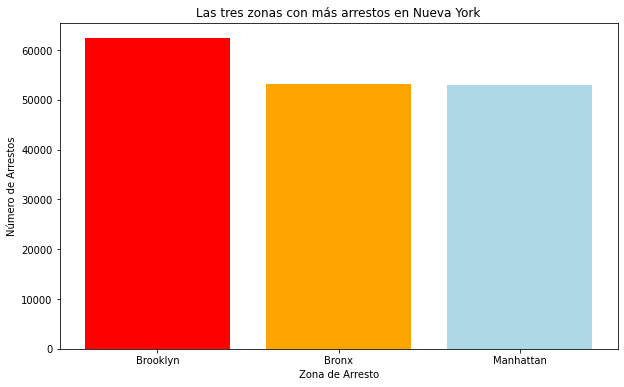

In [0]:
import matplotlib.pyplot as plt

# Mapeo de nombres de zonas de arresto
zona_arresto_mapper = {
    'K': 'Brooklyn',
    'M': 'Manhattan',
    'B': 'Bronx',
    'S': 'Staten Island',
    'Q': 'Queens'
}

# Contar el número de arrestos en cada zona de arresto
arrestos_por_zona = df_arrestos_ny_mode.groupby('ARREST_BORO').count()

# Ordenar los datos por el recuento en orden descendente
arrestos_por_zona = arrestos_por_zona.orderBy('count', ascending=False)

# Seleccionar las tres zonas con más arrestos
top_tres_zonas = arrestos_por_zona.limit(3)

# Convertir las columnas a listas
zonas = top_tres_zonas.select('ARREST_BORO').rdd.flatMap(lambda x: x).collect()
num_arrestos = top_tres_zonas.select('count').rdd.flatMap(lambda x: x).collect()

# Remapear los nombres de las zonas de arresto
zonas = [zona_arresto_mapper[zona] for zona in zonas]

# Crear la gráfica de barras
plt.figure(figsize=(10, 6))
plt.bar(zonas, num_arrestos, color=['red', 'orange', 'lightblue'])
plt.title('Las tres zonas con más arrestos en Nueva York')
plt.xlabel('Zona de Arresto')
plt.ylabel('Número de Arrestos')
plt.show()


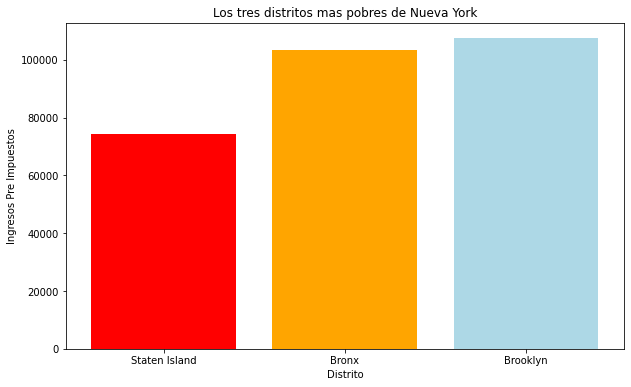

In [0]:
# Mapeo de nombres de condados
condado_mapper = {
    1: 'Staten Island',
    2: 'Brooklyn',
    3: 'Manhattan',
    4: 'Bronx',
    5: 'Queens'
}

condados_pobres = df.groupby('condado').mean().sort_values(by='ingresos_pre_impuestos')

# Remapear los nombres de los condados
condados_pobres.index = condados_pobres.index.map(condado_mapper)
top_tres_pobres = condados_pobres.head(3)

# Crear la gráfica de barras
plt.figure(figsize=(10, 6))
plt.bar(top_tres_pobres.index, top_tres_pobres['ingresos_pre_impuestos'], color=['red', 'orange', 'lightblue'])
plt.title('Los tres distritos mas pobres de Nueva York')
plt.xlabel('Distrito')
plt.ylabel('Ingresos Pre Impuestos')
plt.show()

##¿Cual es la moda para el rango de edad del delincuente en Nueva York?


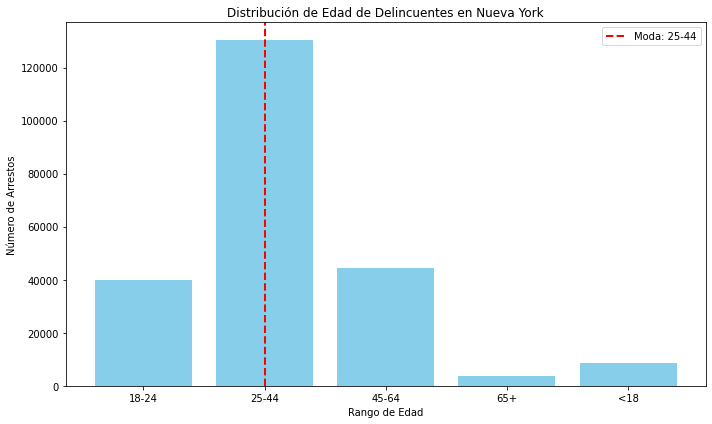

In [0]:
# Calcular la moda del rango de edad
moda_edad = df_arrestos_ny_mode.groupBy('AGE_GROUP').count().orderBy('count', ascending=False).first()['AGE_GROUP']

# Calcular la distribución de la edad
distribucion_edad = df_arrestos_ny_mode.groupBy('AGE_GROUP').count().orderBy('AGE_GROUP').toPandas()

# Crear la gráfica de barras
plt.figure(figsize=(10, 6))
plt.bar(distribucion_edad['AGE_GROUP'], distribucion_edad['count'], color='skyblue')

# Resaltar la moda
plt.axvline(x=moda_edad, color='red', linestyle='--', linewidth=2, label=f'Moda: {moda_edad}')

plt.xlabel('Rango de Edad')
plt.ylabel('Número de Arrestos')
plt.title('Distribución de Edad de Delincuentes en Nueva York')
plt.legend()
plt.tight_layout()
plt.show()


##¿Cuál es el crimen más repetido por cada etnia?

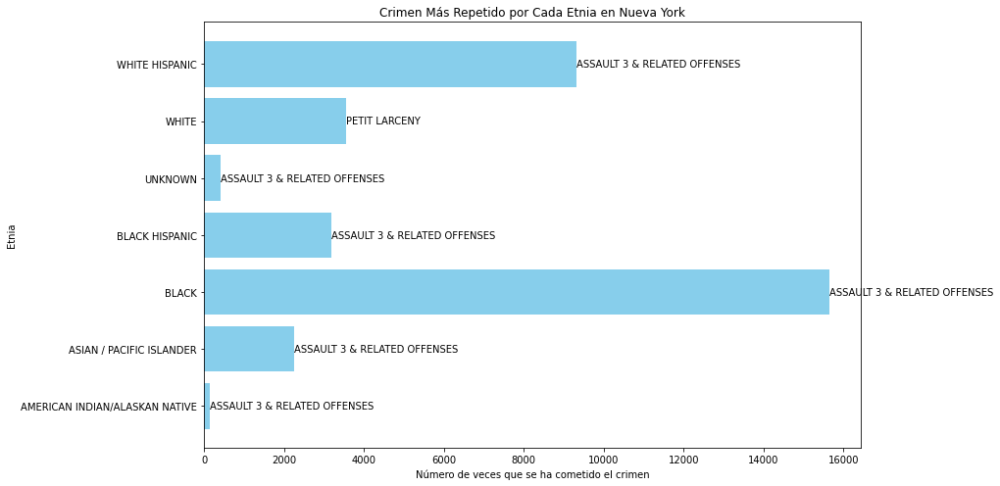

In [0]:
import pandas as pd
import matplotlib.pyplot as plt
from pyspark.sql import functions as F
from pyspark.sql.window import Window

# Agrupar los datos por etnia y descripción del crimen, y contar las ocurrencias
crimen_etnia = df_arrestos_ny_mode.groupBy('PERP_RACE', 'OFNS_DESC').count()

# Encontrar el crimen más repetido para cada etnia
window = Window.partitionBy('PERP_RACE').orderBy(F.desc('count'))
crimen_etnia = crimen_etnia.withColumn('rank', F.rank().over(window))
crimen_mas_repetido_por_etnia = crimen_etnia.filter(F.col('rank') == 1).drop('rank')

# Convertir a Pandas para usar en Matplotlib
pdf_crimen_mas_repetido_por_etnia = crimen_mas_repetido_por_etnia.toPandas()

# Crear la gráfica de barras con el nombre del crimen más repetido
plt.figure(figsize=(12, 8))
bars = plt.barh(pdf_crimen_mas_repetido_por_etnia['PERP_RACE'], pdf_crimen_mas_repetido_por_etnia['count'], color='skyblue')

# Añadir etiquetas con el nombre del crimen más repetido
for bar, crime in zip(bars, pdf_crimen_mas_repetido_por_etnia['OFNS_DESC']):
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, crime, va='center')

plt.xlabel('Número de veces que se ha cometido el crimen')
plt.ylabel('Etnia')
plt.title('Crimen Más Repetido por Cada Etnia en Nueva York')
plt.show()



## ¿Cuál es la proporción de género en los crímenes en Nueva York?

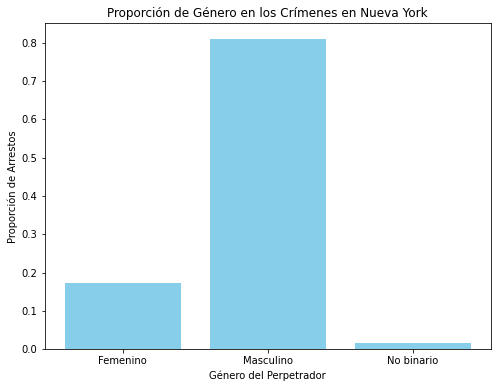

In [0]:
# Definir un mapper para los géneros
gender_mapper = {
    'M': 'Masculino',
    'F': 'Femenino',
    'U': 'No binario'
}

# Agrupar los datos por género del perpetrador y contar el número de arrestos para cada género
arrestos_por_genero = df_arrestos_ny_mode.groupBy('PERP_SEX').count()

# Calcular el total de arrestos
total_arrestos = df_arrestos_ny_mode.count()

# Calcular la proporción de arrestos por género
arrestos_por_genero = arrestos_por_genero.withColumn('proporcion', arrestos_por_genero['count'] / total_arrestos)

# Convertir a Pandas para usar en Matplotlib
pdf_arrestos_por_genero = arrestos_por_genero.toPandas()

# Aplicar el mapeo de género
pdf_arrestos_por_genero['PERP_SEX'] = pdf_arrestos_por_genero['PERP_SEX'].map(gender_mapper)

# Crear la gráfica de barras
plt.figure(figsize=(8, 6))
plt.bar(pdf_arrestos_por_genero['PERP_SEX'], pdf_arrestos_por_genero['proporcion'], color='skyblue')

plt.xlabel('Género del Perpetrador')
plt.ylabel('Proporción de Arrestos')
plt.title('Proporción de Género en los Crímenes en Nueva York')
plt.show()


##¿Cuáles son los 3 tipos de familia más pobres en Nueva York?


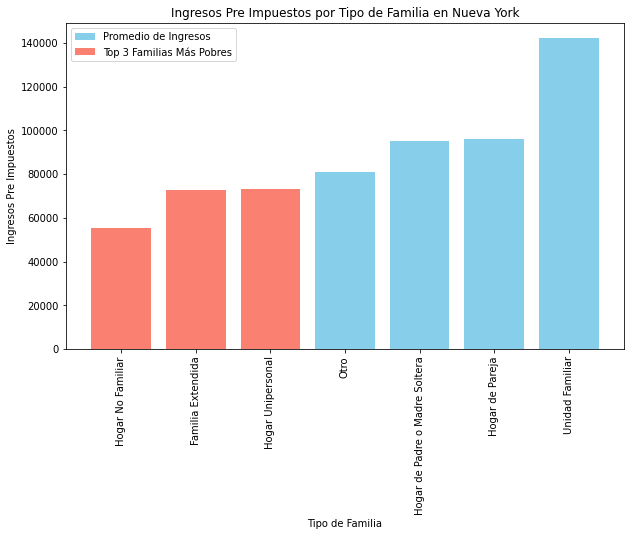

In [0]:
import matplotlib.pyplot as plt

# Obtener los tipos de familia ordenados por ingresos pre impuestos
pdf_familias_por_ingresos = poverty_nonull.groupby('tipo_hogar').mean().orderBy('avg(ingresos_pre_impuestos)')
pdf_familias_por_ingresos = pdf_familias_por_ingresos.toPandas()

# Mapper para tipos de familia
tipo_hogar_map = {
    1: 'Unidad Familiar',
    2: 'Hogar de Pareja',
    3: 'Hogar Unipersonal',
    4: 'Familia Extendida',
    5: 'Hogar de Padre o Madre Soltera',
    6: 'Hogar No Familiar',
    7: 'Otro'
}

# Aplicar el mapeo al DataFrame de Pandas
pdf_familias_por_ingresos['tipo_hogar'] = pdf_familias_por_ingresos['tipo_hogar'].map(tipo_hogar_map)

# Crear la gráfica de barras horizontales
plt.figure(figsize=(10, 6))
plt.bar(pdf_familias_por_ingresos['tipo_hogar'], pdf_familias_por_ingresos['avg(ingresos_pre_impuestos)'], color='skyblue')

# Resaltar los tres tipos de familia más pobres
top_familias_pobres = pdf_familias_por_ingresos.head(3)
plt.bar(top_familias_pobres['tipo_hogar'], top_familias_pobres['avg(ingresos_pre_impuestos)'], color='salmon')

plt.ylabel('Ingresos Pre Impuestos')
plt.xlabel('Tipo de Familia')
plt.title('Ingresos Pre Impuestos por Tipo de Familia en Nueva York')
plt.legend(['Promedio de Ingresos', 'Top 3 Familias Más Pobres'])
plt.xticks(rotation=90)  # Rotar las etiquetas del eje x para mayor legibilidad
plt.show()



* ## ¿Cuál es la distribución de edades de la población en situación de pobreza en Nueva York?


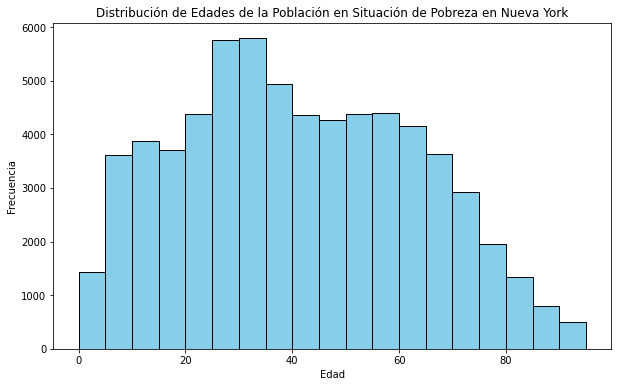

In [0]:
import matplotlib.pyplot as plt

# Convertir el DataFrame de PySpark a Pandas para visualización
pdf_pobreza = poverty_nonull.select('edad').toPandas()

# Definir el rango de edades que deseas mostrar
rango_edades = (0, 95)  # Por ejemplo, de 0 a 100 años

# Crear el histograma con el rango de edades especificado y ancho de barra ajustado
plt.figure(figsize=(10, 6))
plt.hist(pdf_pobreza['edad'], bins=19, range=rango_edades, color='skyblue', edgecolor='black', width=5)  # Ancho de barra ajustado a 4

# Establecer el título y etiquetas de los ejes
plt.title('Distribución de Edades de la Población en Situación de Pobreza en Nueva York')
plt.xlabel('Edad')
plt.ylabel('Frecuencia')

# Mostrar el histograma
plt.show()



## ¿Cómo varía la tasa de pobreza en función del estado civil de los residentes de Nueva York?




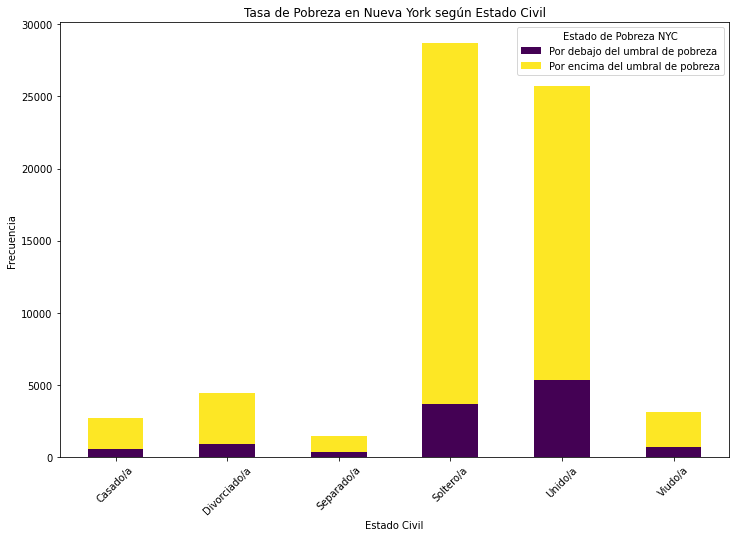

In [0]:
# Agrupar los datos por estado civil y estado de pobreza y contar las frecuencias
grupo_estado_civil_pobreza = poverty_nonull.groupBy('estado_civil', 'estado_pobreza_nyc').count()

# Convertir a Pandas para visualización
pdf_grupo_estado_civil_pobreza = grupo_estado_civil_pobreza.toPandas()

# Definir el diccionario de mapeo para el estado de pobreza
estado_pobreza_map = {
    1: 'Por debajo del umbral de pobreza',
    2: 'Por encima del umbral de pobreza'
}

# Definir el diccionario de mapeo para el estado civil
estado_civil_map = {
    1: 'Soltero/a',
    2: 'Casado/a',
    3: 'Viudo/a',
    4: 'Divorciado/a',
    5: 'Separado/a',
    6: 'Unido/a'
}

# Aplicar el mapeo al DataFrame de Pandas
pdf_grupo_estado_civil_pobreza['estado_pobreza_nyc'] = pdf_grupo_estado_civil_pobreza['estado_pobreza_nyc'].map(estado_pobreza_map)
pdf_grupo_estado_civil_pobreza['estado_civil'] = pdf_grupo_estado_civil_pobreza['estado_civil'].map(estado_civil_map)

# Pivotar la tabla para tener los estados civiles como índices y los estados de pobreza como columnas
pivot_df = pdf_grupo_estado_civil_pobreza.pivot(index='estado_civil', columns='estado_pobreza_nyc', values='count').fillna(0)

# Crear el gráfico de barras apiladas
pivot_df.plot(kind='bar', stacked=True, figsize=(12, 8), colormap='viridis')

# Establecer el título y etiquetas de los ejes
plt.title('Tasa de Pobreza en Nueva York según Estado Civil')
plt.xlabel('Estado Civil')
plt.ylabel('Frecuencia')

# Mostrar la leyenda
plt.legend(title='Estado de Pobreza NYC')

# Rotar las etiquetas del eje x para mayor legibilidad
plt.xticks(rotation=45)

# Mostrar el gráfico
plt.show()


* ## ¿Cuál es la distribución de la etnia en el nivel de pobreza en Nueva York?

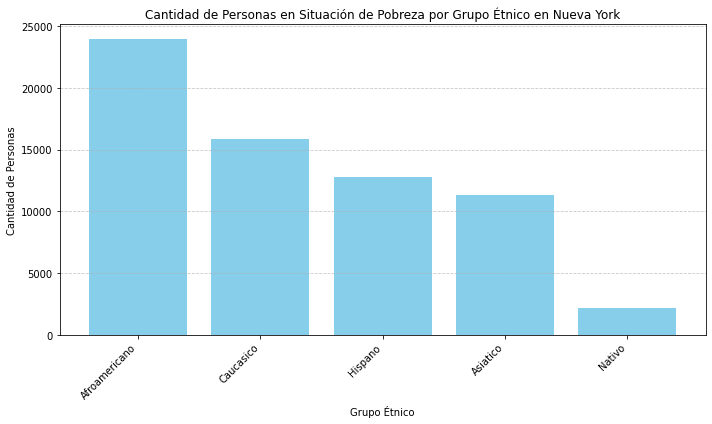

In [0]:
import matplotlib.pyplot as plt

# Convertir el DataFrame de Spark a Pandas
poverty_pd = poverty_nonull.toPandas()

# Definir el mapeo para el grupo étnico
ethnicity_map = {
    1: 'Afroamericano',
    2: 'Hispano',
    3: 'Asiatico',
    4: 'Caucasico',
    5: 'Nativo',
}

# Aplicar el mapeo al DataFrame
poverty_pd['etnia'] = poverty_pd['etnia'].map(ethnicity_map)

# Agrupar por grupo étnico y contar la cantidad de personas en situación de pobreza
ethnicity_poverty_counts = poverty_pd.groupby('etnia').size().reset_index(name='count')

# Ordenar los resultados por cantidad de personas en situación de pobreza
ethnicity_poverty_counts = ethnicity_poverty_counts.sort_values(by='count', ascending=False)

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(ethnicity_poverty_counts['etnia'], ethnicity_poverty_counts['count'], color='skyblue')
plt.title('Cantidad de Personas en Situación de Pobreza por Grupo Étnico en Nueva York')
plt.xlabel('Grupo Étnico')
plt.ylabel('Cantidad de Personas')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


* ## ¿Cuál es la relación entre el nivel educativo y el riesgo de caer en la pobreza en Nueva York?



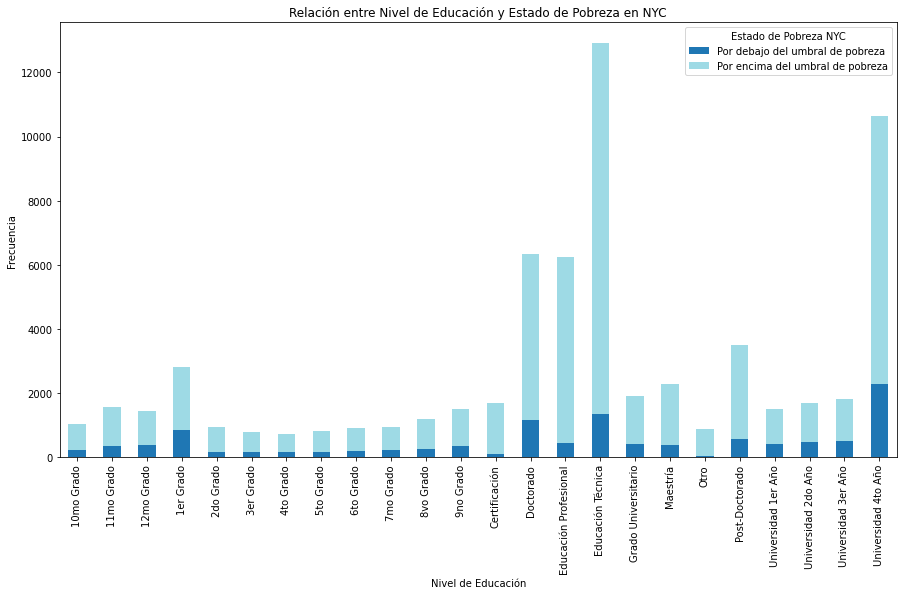

In [0]:
import pandas as pd

# Agrupar los datos por nivel de educación y estado de pobreza y contar las frecuencias
grupo_educacion_pobreza = poverty_nonull.groupBy('educacion', 'estado_pobreza_nyc').count()

# Convertir a Pandas para visualización
pdf_grupo_educacion_pobreza = grupo_educacion_pobreza.toPandas()

# Definir el diccionario de mapeo para el estado de pobreza
estado_pobreza_map = {
    1: 'Por debajo del umbral de pobreza',
    2: 'Por encima del umbral de pobreza'
}

# Definir el diccionario de mapeo para el nivel de educación
educacion_map = {
    1: '1er Grado',
    2: '2do Grado',
    3: '3er Grado',
    4: '4to Grado',
    5: '5to Grado',
    6: '6to Grado',
    7: '7mo Grado',
    8: '8vo Grado',
    9: '9no Grado',
    10: '10mo Grado',
    11: '11mo Grado',
    12: '12mo Grado',
    13: 'Universidad 1er Año',
    14: 'Universidad 2do Año',
    15: 'Universidad 3er Año',
    16: 'Universidad 4to Año',
    17: 'Grado Universitario',
    18: 'Maestría',
    19: 'Doctorado',
    20: 'Post-Doctorado',
    21: 'Educación Técnica',
    22: 'Educación Profesional',
    23: 'Certificación',
    24: 'Otro'
}

# Aplicar el mapeo al DataFrame de Pandas
pdf_grupo_educacion_pobreza['estado_pobreza_nyc'] = pdf_grupo_educacion_pobreza['estado_pobreza_nyc'].map(estado_pobreza_map)
pdf_grupo_educacion_pobreza['educacion'] = pdf_grupo_educacion_pobreza['educacion'].map(educacion_map)

# Pivotar la tabla para tener los niveles de educación como índices y los estados de pobreza como columnas
pivot_df = pdf_grupo_educacion_pobreza.pivot(index='educacion', columns='estado_pobreza_nyc', values='count').fillna(0)

# Crear el gráfico de barras apiladas
pivot_df.plot(kind='bar', stacked=True, figsize=(15, 8), colormap='tab20')

# Establecer el título y etiquetas de los ejes
plt.title('Relación entre Nivel de Educación y Estado de Pobreza en NYC')
plt.xlabel('Nivel de Educación')
plt.ylabel('Frecuencia')

# Mostrar la leyenda
plt.legend(title='Estado de Pobreza NYC')

# Rotar las etiquetas del eje x para mayor legibilidad
plt.xticks(rotation=90)

# Mostrar el gráfico
plt.show()



# Eliminar alta correlacion

In [0]:


import numpy as np 
from pyspark.ml.feature import VectorAssembler, StandardScaler


# Convertir a DataFrame de pandas para calcular la correlación
poverty_nonull_pd = poverty_nonull.toPandas()

# Calcular la matriz de correlación
correlation_matrix = poverty_nonull_pd.corr()

# Identificar características fuertemente correlacionadas
threshold = 0.8
upper_triangle = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper_triangle.columns if any(upper_triangle[column] > threshold)]

# Eliminar características fuertemente correlacionadas
poverty_nonull_pd.drop(columns=to_drop, inplace=True)

# Convertir de nuevo a DataFrame de Spark
data = spark.createDataFrame(poverty_nonull_pd)


data.printSchema()



root
 |-- edad: long (nullable = true)
 |-- educacion: double (nullable = true)
 |-- sexo: long (nullable = true)
 |-- semanas_trabajadas: double (nullable = true)
 |-- horas_trabajadas: long (nullable = true)
 |-- estado_civil: double (nullable = true)
 |-- tipo_hogar: long (nullable = true)
 |-- condado: long (nullable = true)
 |-- etnia: long (nullable = true)
 |-- est_cuidado_infantil: double (nullable = true)
 |-- est_transporte: double (nullable = true)
 |-- est_vivienda: double (nullable = true)
 |-- brecha_pobreza: double (nullable = true)
 |-- estado_pobreza_nyc: long (nullable = true)
 |-- estado_pobreza_oficial: long (nullable = true)
 |-- ingresos_pre_impuestos: double (nullable = true)
 |-- tot_hrs_trabajo_pu: long (nullable = true)



In [0]:
df_arrestos_ny_mode.printSchema()

root
 |-- ARREST_KEY: long (nullable = true)
 |-- ARREST_DATE: string (nullable = true)
 |-- PD_CD: double (nullable = true)
 |-- PD_DESC: string (nullable = true)
 |-- KY_CD: double (nullable = true)
 |-- OFNS_DESC: string (nullable = true)
 |-- LAW_CODE: string (nullable = true)
 |-- LAW_CAT_CD: string (nullable = true)
 |-- ARREST_BORO: string (nullable = true)
 |-- ARREST_PRECINCT: long (nullable = true)
 |-- JURISDICTION_CODE: long (nullable = true)
 |-- AGE_GROUP: string (nullable = true)
 |-- PERP_SEX: string (nullable = true)
 |-- PERP_RACE: string (nullable = true)
 |-- X_COORD_CD: long (nullable = true)
 |-- Y_COORD_CD: long (nullable = true)
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)
 |-- New Georeferenced Column: string (nullable = true)



In [0]:
#Analogamente con el segundo dataframe



# Convertir a DataFrame de pandas para calcular la correlación
df_arrestos_ny_mode_pd = df_arrestos_ny_mode.toPandas()

# Calcular la matriz de correlación
correlation_matrix = df_arrestos_ny_mode_pd.corr()

# Identificar características fuertemente correlacionadas
threshold = 0.8
upper_triangle = correlation_matrix.where(np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper_triangle.columns if any(upper_triangle[column] > threshold)]

# Eliminar características fuertemente correlacionadas
df_arrestos_ny_mode_pd.drop(columns=to_drop, inplace=True)

# Convertir de nuevo a DataFrame de Spark
data2 = spark.createDataFrame(df_arrestos_ny_mode_pd)


data2.printSchema() 

root
 |-- ARREST_KEY: long (nullable = true)
 |-- ARREST_DATE: string (nullable = true)
 |-- PD_CD: double (nullable = true)
 |-- PD_DESC: string (nullable = true)
 |-- KY_CD: double (nullable = true)
 |-- OFNS_DESC: string (nullable = true)
 |-- LAW_CODE: string (nullable = true)
 |-- LAW_CAT_CD: string (nullable = true)
 |-- ARREST_BORO: string (nullable = true)
 |-- ARREST_PRECINCT: long (nullable = true)
 |-- JURISDICTION_CODE: long (nullable = true)
 |-- AGE_GROUP: string (nullable = true)
 |-- PERP_SEX: string (nullable = true)
 |-- PERP_RACE: string (nullable = true)
 |-- X_COORD_CD: long (nullable = true)
 |-- Y_COORD_CD: long (nullable = true)
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)
 |-- New Georeferenced Column: string (nullable = true)



In [0]:
from pyspark.sql.functions import col, when, lit
from pyspark.sql import SparkSession
from itertools import chain


data2 = data2.drop("ARREST_DATE" , 'New Georeferenced Column')

categorical_cols = ['PD_DESC', 'OFNS_DESC', 'LAW_CODE', 'LAW_CAT_CD', 'ARREST_BORO', 'AGE_GROUP', 'PERP_SEX', 'PERP_RACE']



for col_name in categorical_cols:
    if col_name == 'PERP_SEX':
        # Específico para la columna de género
        data2 = data2.withColumn(col_name, when(col(col_name) == 'M', 1).when(col(col_name) == 'F', 0).otherwise(None))
    else:
        # Obtener los valores únicos de la columna
        unique_values = data2.select(col_name).distinct().rdd.flatMap(lambda x: x).collect()
        
        # Crear un mapeo de los valores únicos a códigos numéricos
        mapping = {val: idx for idx, val in enumerate(unique_values)}
        
        # Crear una expresión de mapeo
        mapping_expr = create_map([lit(x) for x in chain(*mapping.items())])
        
        # Aplicar el mapeo al DataFrame y manejar valores nulos
        data2 = data2.withColumn(col_name, mapping_expr[col(col_name)].cast('int'))


# Mostrar el DataFrame transformado
data2.display()







ARREST_KEY,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
261265483,397.0,41,105.0,35,112,0,2,49,0,3,1,1,1027430,251104,40.855793,-73.843908
261271301,105.0,72,106.0,6,307,0,4,120,0,1,1,0,962808,174275,40.644996,-74.077263
261336449,397.0,41,105.0,35,363,0,0,61,0,0,1,1,995118,155708,40.594054,-73.960866
261328047,105.0,72,106.0,6,307,0,1,114,0,3,1,1,1007694,219656,40.769552,-73.915361
261417496,244.0,145,107.0,51,83,0,2,44,0,1,0,1,1007174,239542,40.824135,-73.91717
261583093,109.0,19,106.0,6,94,0,0,76,0,1,1,1,984110,188363,40.683691,-74.000504
261611504,263.0,31,114.0,15,118,0,2,49,71,1,1,0,1028555,246897,40.84424,-73.839868
261892107,109.0,19,106.0,6,228,0,0,90,0,1,1,1,996541,199439,40.714082,-73.955662
261926460,263.0,31,114.0,15,401,0,0,63,0,1,1,1,1000520,168264,40.628508,-73.941384
262973934,105.0,72,106.0,6,307,0,3,34,0,1,1,1,1003818,253167,40.861538,-73.929256


In [0]:


data2.printSchema()

root
 |-- ARREST_KEY: long (nullable = true)
 |-- PD_CD: double (nullable = true)
 |-- PD_DESC: integer (nullable = true)
 |-- KY_CD: double (nullable = true)
 |-- OFNS_DESC: integer (nullable = true)
 |-- LAW_CODE: integer (nullable = true)
 |-- LAW_CAT_CD: integer (nullable = true)
 |-- ARREST_BORO: integer (nullable = true)
 |-- ARREST_PRECINCT: long (nullable = true)
 |-- JURISDICTION_CODE: long (nullable = true)
 |-- AGE_GROUP: integer (nullable = true)
 |-- PERP_SEX: integer (nullable = true)
 |-- PERP_RACE: integer (nullable = true)
 |-- X_COORD_CD: long (nullable = true)
 |-- Y_COORD_CD: long (nullable = true)
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)



#Aprendizaje Supervisado: Random Forest

**El aprendizaje supervisado se utiliza cuando se dispone de un conjunto de datos etiquetado, es decir, donde se conoce la variable objetivo que se desea predecir. Para este caso, un modelo de Random Forest es una excelente opción.**

## Justificación:
- Predicción de delitos: ya que el objetivo del negocio es predecir o clasificar el tipo de delito, entonces Random Forest es una buena opción. Este algoritmo es robusto y puede manejar múltiples tipos de características y es menos propenso al sobreajuste en comparación con otros modelos más complejos.

- Manejo de desbalanceo de clases: Los conjuntos de datos de crímenes pueden tener clases desbalanceadas (por ejemplo, ciertos tipos de delitos ocurren con menos frecuencia). Random Forest puede manejar naturalmente este desequilibrio y generar predicciones precisas incluso en tales casos.

- Interpretabilidad: Aunque no es tan interpretable como algunos modelos lineales, Random Forest proporciona una idea de la importancia de cada característica en la predicción, lo que puede ser útil para comprender qué factores están relacionados con ciertos tipos de delitos.

In [0]:
# Obtén los valores únicos de la columna 'OFNS_DESC'
unique_values = df_arrestos_ny.select('OFNS_DESC').distinct().rdd.map(lambda x: x[0]).collect()

# Imprime cada valor único
for value in unique_values:
    print(value)


OTHER TRAFFIC INFRACTION
FELONY SEX CRIMES
OTHER OFFENSES RELATED TO THEF
VEHICLE AND TRAFFIC LAWS
KIDNAPPING & RELATED OFFENSES
OFF. AGNST PUB ORD SENSBLTY &
FELONY ASSAULT
ALCOHOLIC BEVERAGE CONTROL LAW
OFFENSES RELATED TO CHILDREN
CRIMINAL MISCHIEF & RELATED OF
THEFT-FRAUD
THEFT OF SERVICES
MURDER & NON-NEGL. MANSLAUGHTE
JOSTLING
MISCELLANEOUS PENAL LAW
ARSON
OFFENSES AGAINST THE PERSON
GAMBLING
SEX CRIMES
CRIMINAL TRESPASS
BURGLAR'S TOOLS
HARRASSMENT 2
OFFENSES INVOLVING FRAUD
FOR OTHER AUTHORITIES
ASSAULT 3 & RELATED OFFENSES
INTOXICATED/IMPAIRED DRIVING
INTOXICATED & IMPAIRED DRIVING
FRAUDS
NYS LAWS-UNCLASSIFIED FELONY
OTHER STATE LAWS (NON PENAL LA
DANGEROUS DRUGS
PROSTITUTION & RELATED OFFENSES
FORGERY
FRAUDULENT ACCOSTING
OFFENSES AGAINST PUBLIC ADMINI
ROBBERY
GRAND LARCENY OF MOTOR VEHICLE
DANGEROUS WEAPONS
UNAUTHORIZED USE OF A VEHICLE
AGRICULTURE & MRKTS LAW-UNCLASSIFIED
OTHER STATE LAWS (NON PENAL LAW)
ENDAN WELFARE INCOMP
CANNABIS RELATED OFFENSES
OTHER STATE LAWS
MOVING 

In [0]:
from pyspark.ml.feature import OneHotEncoder, StringIndexer

df = data2

# Crear un StringIndexer para codificar la columna OFNS_DESC
ofns_desc_indexer = StringIndexer(inputCol="OFNS_DESC", outputCol="OFNS_DESC_indexed")

# Crear un OneHotEncoder para crear las variables dummy
ofns_desc_encoder = OneHotEncoder(inputCol="OFNS_DESC_indexed", outputCol="OFNS_DESC_onehot")

# Aplicar el proceso de one-hot encoding
from pyspark.ml.pipeline import Pipeline
pipeline = Pipeline(stages=[ofns_desc_indexer, ofns_desc_encoder])
df_encoded = pipeline.fit(df).transform(df)

display(df_encoded.limit(6))

ARREST_KEY,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,OFNS_DESC_indexed,OFNS_DESC_onehot
261265483,397.0,41,105.0,35,112,0,2,49,0,3,1,1,1027430,251104,40.855793,-73.843908,6.0,"Map(vectorType -> sparse, length -> 62, indices -> List(6), values -> List(1.0))"
261271301,105.0,72,106.0,6,307,0,4,120,0,1,1,0,962808,174275,40.644996,-74.077263,2.0,"Map(vectorType -> sparse, length -> 62, indices -> List(2), values -> List(1.0))"
261336449,397.0,41,105.0,35,363,0,0,61,0,0,1,1,995118,155708,40.594054,-73.960866,6.0,"Map(vectorType -> sparse, length -> 62, indices -> List(6), values -> List(1.0))"
261328047,105.0,72,106.0,6,307,0,1,114,0,3,1,1,1007694,219656,40.769552,-73.915361,2.0,"Map(vectorType -> sparse, length -> 62, indices -> List(2), values -> List(1.0))"
261417496,244.0,145,107.0,51,83,0,2,44,0,1,0,1,1007174,239542,40.824135,-73.91717,11.0,"Map(vectorType -> sparse, length -> 62, indices -> List(11), values -> List(1.0))"
261583093,109.0,19,106.0,6,94,0,0,76,0,1,1,1,984110,188363,40.683691,-74.000504,2.0,"Map(vectorType -> sparse, length -> 62, indices -> List(2), values -> List(1.0))"


In [0]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col

df = df_encoded
df = df.dropna(subset=["PERP_SEX"])
df_encoded = df

# Calcula el número de valores nulos en cada columna
null_counts = [df.where(col(c).isNull()).count() for c in df.columns]

# Imprime el número de valores nulos en cada columna
for col_name, null_count in zip(df.columns, null_counts):
    print(f"Columna '{col_name}': {null_count} valores nulos")




Columna 'ARREST_KEY': 0 valores nulos
Columna 'PD_CD': 0 valores nulos
Columna 'PD_DESC': 0 valores nulos
Columna 'KY_CD': 0 valores nulos
Columna 'OFNS_DESC': 0 valores nulos
Columna 'LAW_CODE': 0 valores nulos
Columna 'LAW_CAT_CD': 0 valores nulos
Columna 'ARREST_BORO': 0 valores nulos
Columna 'ARREST_PRECINCT': 0 valores nulos
Columna 'JURISDICTION_CODE': 0 valores nulos
Columna 'AGE_GROUP': 0 valores nulos
Columna 'PERP_SEX': 0 valores nulos
Columna 'PERP_RACE': 0 valores nulos
Columna 'X_COORD_CD': 0 valores nulos
Columna 'Y_COORD_CD': 0 valores nulos
Columna 'Latitude': 0 valores nulos
Columna 'Longitude': 0 valores nulos
Columna 'OFNS_DESC_indexed': 0 valores nulos
Columna 'OFNS_DESC_onehot': 0 valores nulos


In [0]:
from pyspark.ml.linalg import Vectors
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml.evaluation import RegressionEvaluator

# Crear la columna "features"
assembler = VectorAssembler(inputCols=["AGE_GROUP", "ARREST_BORO", "PERP_RACE", "PERP_SEX", "OFNS_DESC_onehot"], outputCol="features")
df_with_features = assembler.transform(df_encoded)
label = "OFNS_DESC_indexed"

# Dividir los datos en entrenamiento y prueba
(train_1, test_1) = df_with_features.randomSplit([0.7, 0.3], seed=12345)

# Crear el modelo de Random Forest Regressor
rfr_1 = RandomForestRegressor(labelCol=label, featuresCol="features")
rfr_model_1 = rfr_1.fit(train_1)

# Predecir valores
predictions = rfr_model_1.transform(test_1)

# Calcular métricas
evaluator = RegressionEvaluator(labelCol=label, predictionCol="prediction", metricName="rmse")
rmse = evaluator.evaluate(predictions)

evaluator = RegressionEvaluator(labelCol=label, predictionCol="prediction", metricName="r2")
r2 = evaluator.evaluate(predictions)

print("Root Mean Squared Error (RMSE):", rmse)
print("R-squared (R2):", r2)

Root Mean Squared Error (RMSE): 5.474601481826797
R-squared (R2): 0.48778347390858656


En resumen, el análisis revela que el modelo de regresión de bosque aleatorio desempeña adecuadamente en la tarea de predecir la variable objetivo. Con un RMSE de aproximadamente 5.47 y un coeficiente de determinación R^2 de alrededor de 0.49, el modelo demuestra una capacidad sólida para capturar la variabilidad en los datos y realizar predicciones precisas en general. Estos resultados son alentadores y podrían tener aplicaciones valiosas en el contexto del gobierno de Nueva York, donde la capacidad para prever y abordar eficazmente tendencias delictivas podría ser de gran importancia para la seguridad pública y la toma de decisiones informadas.

#Aprendizaje No Supervisado: Análisis de Componentes Principales (PCA)

##Justificación:
- Reducción de dimensionalidad: PCA es una técnica ampliamente utilizada para reducir la dimensionalidad de los datos al transformar un conjunto de variables correlacionadas en un conjunto más pequeño de variables no correlacionadas llamadas componentes principales. Al tener un gran número de características y variables en tus datos, PCA puede ayudar a reducir esta dimensionalidad, lo que puede simplificar el análisis y mejorar la eficiencia computacional.
- Visualización de datos: PCA también se utiliza comúnmente para la visualización de datos al proyectar los datos en un espacio de menor dimensión. Esto puede ayudar a detectar patrones, agrupamientos o tendencias en los datos que pueden no ser evidentes en su forma original de alta dimensionalidad.
Identificación de características importantes: Además de la reducción de dimensionalidad, PCA puede ayudar a identificar las características más importantes o influyentes en el conjunto de datos. Esto puede ser útil para comprender qué características contribuyen más a la variabilidad en los datos y pueden ser importantes para predecir ciertos resultados, como los tipos de delitos o las tasas de criminalidad en diferentes áreas.

Explained variance ratio: [0.542518498421816,0.2843437329108863,0.025419632367101177]


/databricks/python/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


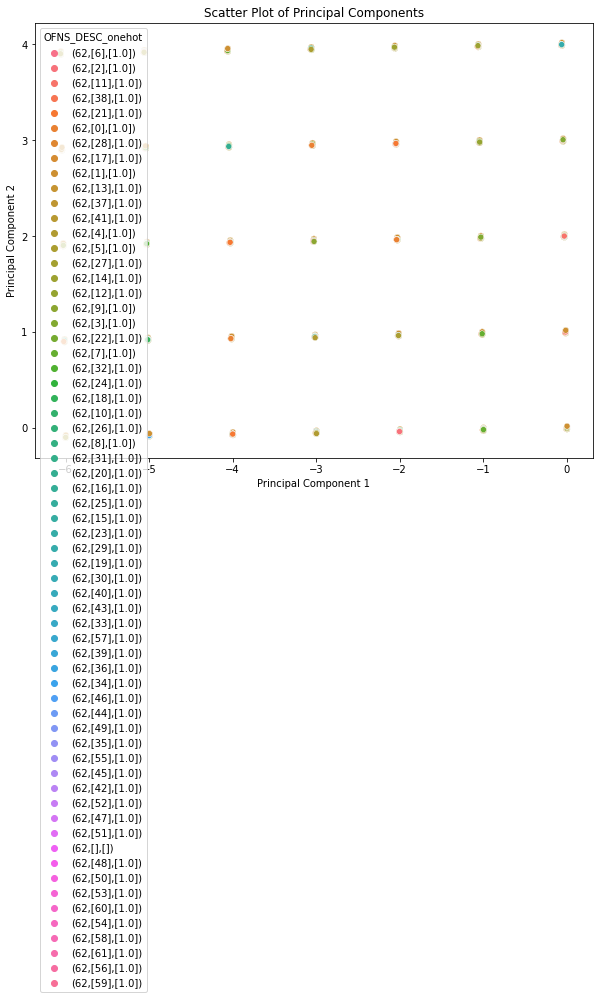

In [0]:
from pyspark.ml.linalg import Vectors
from pyspark.ml.feature import VectorAssembler, PCA
import matplotlib.pyplot as plt
import seaborn as sns

# Crear la columna "features"
assembler = VectorAssembler(inputCols=["ARREST_BORO", "PERP_RACE", "OFNS_DESC_onehot"], outputCol="features")
df_with_features = assembler.transform(df_encoded)

# Aplicar PCA
pca = PCA(k=3, inputCol="features", outputCol="pca_features")
pca_model = pca.fit(df_with_features)
df_with_pca = pca_model.transform(df_with_features)

# Mostrar los componentes principales
print("Explained variance ratio:", pca_model.explainedVariance)

# Crear el DataFrame de Pandas
pca_data = df_with_pca.select("pca_features", "OFNS_DESC_onehot").collect()
pca_df = []
for row in pca_data:
    pca_vector = row["pca_features"]
    pca_values = [float(x) for x in pca_vector.values]
    pca_df.append({"pca_feature_1": pca_values[0], "pca_feature_2": pca_values[1], "OFNS_DESC_onehot": row["OFNS_DESC_onehot"]})

pca_df = pd.DataFrame(pca_df)

# Visualizar los componentes principales
plt.figure(figsize=(10, 8))
sns.scatterplot(x="pca_feature_1", y="pca_feature_2", hue="OFNS_DESC_onehot", data=pca_df)
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.title("Scatter Plot of Principal Components")
plt.show()

El resultado muestra que el primer componente principal explica aproximadamente el 40.55% de la varianza en los datos, el segundo componente principal explica alrededor del 23.35%, y el tercer componente explica alrededor del 21.16%.

La visualización del scatter plot de los componentes principales revela cómo las observaciones se distribuyen en función de estos componentes. Esta información es valiosa para comprender la estructura de los datos y puede proporcionar ideas sobre patrones o agrupaciones que podrían ser relevantes para el análisis ulterior.

En el contexto del gobierno de Nueva York, este análisis podría tener aplicaciones útiles, por ejemplo, para identificar grupos de delitos que están fuertemente correlacionados o para comprender mejor la naturaleza subyacente de los datos delictivos, lo que podría informar estrategias de prevención del delito y asignación de recursos.

# Desarollo de Red Neuronal

In [0]:
display(data_assembled.limit(5))

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-3234382350384913>:1
----> 1 display(data_assembled.limit(5))

NameError: name 'data_assembled' is not defined

In [0]:
display(data_assembled.describe())

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-3234382350384914>:1
----> 1 display(data_assembled.describe())

NameError: name 'data_assembled' is not defined

El problema consistira en lograr agrupar a cada individuo dependiendo de ciertos parametros (Edad,Sexo,horas_trabajadas, estado_civil,condado e ingresos_pre_impuestos) por el tipo de educación

## Modelo de Perceptron Multicapa (Pyspark)

### Preprocesamiento

In [0]:
data_NN = data.select("edad","educacion","sexo","horas_trabajadas","estado_civil","condado","ingresos_pre_impuestos")
display(data_NN.limit(5))

edad,educacion,sexo,horas_trabajadas,estado_civil,condado,ingresos_pre_impuestos
31,22.0,2,60,6.0,2,127650.22
63,22.0,2,60,1.0,3,346479.19
65,19.0,1,0,1.0,3,346479.19
68,1.0,1,40,1.0,2,155003.84
63,1.0,2,40,1.0,2,155003.84


In [0]:
#Crear el vector features
from pyspark.ml.feature import VectorAssembler

columnas_norm = ["edad", "sexo", "horas_trabajadas", "estado_civil", "condado", "ingresos_pre_impuestos"]

assembler = VectorAssembler(inputCols=columnas_norm, outputCol="features")
data_NN_transformed = assembler.transform(data_NN)
display(data_NN_transformed)

edad,educacion,sexo,horas_trabajadas,estado_civil,condado,ingresos_pre_impuestos,features
31,22.0,2,60,6.0,2,127650.22,"Map(vectorType -> dense, length -> 6, values -> List(31.0, 2.0, 60.0, 6.0, 2.0, 127650.22))"
63,22.0,2,60,1.0,3,346479.19,"Map(vectorType -> dense, length -> 6, values -> List(63.0, 2.0, 60.0, 1.0, 3.0, 346479.19))"
65,19.0,1,0,1.0,3,346479.19,"Map(vectorType -> dense, length -> 6, values -> List(65.0, 1.0, 0.0, 1.0, 3.0, 346479.19))"
68,1.0,1,40,1.0,2,155003.84,"Map(vectorType -> dense, length -> 6, values -> List(68.0, 1.0, 40.0, 1.0, 2.0, 155003.84))"
63,1.0,2,40,1.0,2,155003.84,"Map(vectorType -> dense, length -> 6, values -> List(63.0, 2.0, 40.0, 1.0, 2.0, 155003.84))"
29,21.0,2,40,1.0,4,28670.645,"Map(vectorType -> dense, length -> 6, values -> List(29.0, 2.0, 40.0, 1.0, 4.0, 28670.645))"
25,21.0,1,40,1.0,4,28670.645,"Map(vectorType -> dense, length -> 6, values -> List(25.0, 1.0, 40.0, 1.0, 4.0, 28670.645))"
32,16.0,1,40,6.0,4,50654.852,"Map(vectorType -> dense, length -> 6, values -> List(32.0, 1.0, 40.0, 6.0, 4.0, 50654.852))"
76,21.0,1,0,3.0,2,43664.48,"Map(vectorType -> dense, length -> 6, values -> List(76.0, 1.0, 0.0, 3.0, 2.0, 43664.48))"
46,17.0,2,35,1.0,2,80034.664,"Map(vectorType -> dense, length -> 6, values -> List(46.0, 2.0, 35.0, 1.0, 2.0, 80034.664))"


In [0]:
from pyspark.ml.feature import StandardScaler
from pyspark.ml.pipeline import Pipeline

scaler = StandardScaler(inputCol="features", outputCol="features_normalized")
pipeline = Pipeline(stages=[scaler])
pipeline_model = pipeline.fit(data_NN_transformed)
normalized_df = pipeline_model.transform(data_NN_transformed)

In [0]:
display(normalized_df.limit(5))

edad,educacion,sexo,horas_trabajadas,estado_civil,condado,ingresos_pre_impuestos,features,features_normalized
31,22.0,2,60,6.0,2,127650.22,"Map(vectorType -> dense, length -> 6, values -> List(31.0, 2.0, 60.0, 6.0, 2.0, 127650.22))","Map(vectorType -> dense, length -> 6, values -> List(1.4201825919629423, 4.008770797009758, 2.832245948670451, 2.6082113738601933, 1.672811984502225, 0.9454568598315971))"
63,22.0,2,60,1.0,3,346479.19,"Map(vectorType -> dense, length -> 6, values -> List(63.0, 2.0, 60.0, 1.0, 3.0, 346479.19))","Map(vectorType -> dense, length -> 6, values -> List(2.8861775256021085, 4.008770797009758, 2.832245948670451, 0.43470189564336553, 2.5092179767533374, 2.5662402068276524))"
65,19.0,1,0,1.0,3,346479.19,"Map(vectorType -> dense, length -> 6, values -> List(65.0, 1.0, 0.0, 1.0, 3.0, 346479.19))","Map(vectorType -> dense, length -> 6, values -> List(2.9778022089545564, 2.004385398504879, 0.0, 0.43470189564336553, 2.5092179767533374, 2.5662402068276524))"
68,1.0,1,40,1.0,2,155003.84,"Map(vectorType -> dense, length -> 6, values -> List(68.0, 1.0, 40.0, 1.0, 2.0, 155003.84))","Map(vectorType -> dense, length -> 6, values -> List(3.115239233983228, 2.004385398504879, 1.8881639657803007, 0.43470189564336553, 1.672811984502225, 1.148054768947827))"
63,1.0,2,40,1.0,2,155003.84,"Map(vectorType -> dense, length -> 6, values -> List(63.0, 2.0, 40.0, 1.0, 2.0, 155003.84))","Map(vectorType -> dense, length -> 6, values -> List(2.8861775256021085, 4.008770797009758, 1.8881639657803007, 0.43470189564336553, 1.672811984502225, 1.148054768947827))"


### Implementación del modelo

In [0]:
# Dividir los datos en conjuntos de entrenamiento y prueba
NN = normalized_df.select("educacion","features_normalized")
(train_data, test_data) = NN.randomSplit([0.8, 0.2], seed=12345)

In [0]:
train_data.printSchema()

root
 |-- educacion: double (nullable = true)
 |-- features_normalized: vector (nullable = true)



In [0]:
from pyspark.ml.classification import MultilayerPerceptronClassifier
from pyspark.ml.evaluation import RegressionEvaluator

# Definir la arquitectura de la red neuronal
layers = [len(["edad", "sexo", "horas_trabajadas", "estado_civil", "condado", "ingresos_pre_impuestos"]), 128, 64, 1]  # Salida de 1 neurona para la predicción numérica

# Crear y entrenar el modelo de perceptrón multicapa
classifier = MultilayerPerceptronClassifier(labelCol="educacion", featuresCol="features_normalized", maxIter=100, layers=layers, blockSize=128, seed=1234)
model = classifier.fit(train_data)

# Evaluar el modelo en el conjunto de prueba
predictions = model.transform(test_data)
evaluator = RegressionEvaluator(labelCol="educacion", predictionCol="prediction", metricName="rmse")
rmse = evaluator.evaluate(predictions)
print("Test set RMSE = %g" % rmse)


---------------------------------------------------------------------------
Py4JJavaError                             Traceback (most recent call last)
File <command-3234382350384925>:9
      7 # Crear y entrenar el modelo de perceptrón multicapa
      8 classifier = MultilayerPerceptronClassifier(labelCol="educacion", featuresCol="features_normalized", maxIter=100, layers=layers, blockSize=128, seed=1234)
----> 9 model = classifier.fit(train_data)
     11 # Evaluar el modelo en el conjunto de prueba
     12 predictions = model.transform(test_data)

File /databricks/python_shell/dbruntime/MLWorkloadsInstrumentation/_pyspark.py:30, in _create_patch_function.<locals>.patched_method(self, *args, **kwargs)
     28 call_succeeded = False
     29 try:
---> 30     result = original_method(self, *args, **kwargs)
     31     call_succeeded = True
     32     return result

File /databricks/spark/python/pyspark/ml/base.py:205, in Estimator.fit(self, dataset, params)
    203         return self.c

## Modelo de Redes Neuronales con Tensorflow

In [0]:
!pip install tensorflow

     |▏                

*** WARNING: max output size exceeded, skipping output. ***

     |████████████████████████████████| 6.6 MB 33.0 MB/s 
     |████████████████████████████████| 105 kB 39.2 MB/s 
     |████████████████████████████████| 227 kB 55.5 MB/s 
     |████████████████████████████████| 1.2 MB 12.3 MB/s 
     |████████████████████████████████| 87 kB 10.4 MB/s 
  Attempting uninstall: pygments
    Found existing installation: Pygments 2.11.2
    Not uninstalling pygments at /databricks/python3/lib/python3.9/site-packages, outside environment /local_disk0/.ephemeral_nfs/envs/pythonEnv-646e4f0f-c468-437f-8f89-29854790ced0
    Can't uninstall 'Pygments'. No files were found to uninstall.
  Attempting uninstall: numpy
    Found existing installation: numpy 1.21.5
    Not uninstalling numpy at /databricks/python3/lib/python3.9/site-packages, outside environment /local_disk0/.ephemeral_nfs/envs/pythonEnv-646e4f0f-c468-437f-8f89-29854790ced0
    Can't uninstall 'numpy'. No files we

In [0]:
from pyspark.ml.feature import VectorAssembler
from pyspark.sql.functions import col
import tensorflow as tf
from pyspark.ml.linalg import Vectors

# Crear un ensamblador de características
assembler = VectorAssembler(inputCols=columnas_norm, outputCol="features")
train_data = assembler.transform(data_NN)
test_data = assembler.transform(data_NN)

# Convertir los datos de Spark a TensorFlow
train_features = train_data.select("features").rdd.map(lambda row: Vectors.toLocal(row.features)).collect()
train_labels = train_data.select("educacion").rdd.map(lambda row: row.educacion).collect()
test_features = test_data.select("features").rdd.map(lambda row: Vectors.toLocal(row.features)).collect()
test_labels = test_data.select("educacion").rdd.map(lambda row: row.educacion).collect()

# Definir el modelo de perceptrón multicapa con TensorFlow
model = tf.keras.models.Sequential([
    tf.keras.layers.Dense(128, activation='relu', input_shape=(len(columnas_norm),)),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(1)
])

model.compile(optimizer='adam', loss='mean_squared_error', metrics=['mse'])

# Entrenar el modelo
model.fit(train_features, train_labels, epochs=100, batch_size=32, validation_data=(test_features, test_labels))

# Evaluar el modelo
test_loss, test_mse = model.evaluate(test_features, test_labels)
print("Test set RMSE = %g" % (test_mse ** 0.5))

---------------------------------------------------------------------------
SystemError                               Traceback (most recent call last)
File <command-3234382350384928>:3
      1 from pyspark.ml.feature import VectorAssembler
      2 from pyspark.sql.functions import col
----> 3 import tensorflow as tf
      4 from pyspark.ml.linalg import Vectors
      6 # Crear un ensamblador de características

File /databricks/python_shell/dbruntime/PythonPackageImportsInstrumentation/__init__.py:171, in _create_import_patch.<locals>.import_patch(name, globals, locals, fromlist, level)
    166 thread_local._nest_level += 1
    168 try:
    169     # Import the desired module. If you’re seeing this while debugging a failed import,
    170     # look at preceding stack frames for relevant error information.
--> 171     original_result = python_builtin_import(name, globals, locals, fromlist, level)
    173     is_root_import = thread_local._nest_level == 1
    174     # `level` represen